# Import Library

In [1]:
!pip install torchvision

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (99 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21

In [2]:
import os
from os import listdir
import os.path as op
from glob import glob
import shutil

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from PIL import Image

import cv2
from google.colab.patches import cv2_imshow

from sklearn.model_selection import  train_test_split, KFold

In [3]:
import torch

from torchvision import datasets , models , transforms
import torchvision.transforms as T
from torch.utils.data import DataLoader, SubsetRandomSampler

import torch.nn as nn
from tqdm.auto import tqdm
import torch.nn.functional as F
from sklearn import metrics
from sklearn.metrics import classification_report, accuracy_score, precision_recall_fscore_support, confusion_matrix

# Load Data and Arrange File Address

In [4]:
!git clone https://github.com/seensiravit/Parkinson-Early-Detection.git

Cloning into 'Parkinson-Early-Detection'...
remote: Enumerating objects: 1248, done.
remote: Counting objects: 100% (708/708), done.
remote: Compressing objects: 100% (677/677), done.
remote: Total 1248 (delta 30), reused 698 (delta 20), pack-reused 540
Receiving objects: 100% (1248/1248), 147.89 MiB | 14.62 MiB/s, done.
Resolving deltas: 100% (44/44), done.


In [5]:
input_grandroot = 'Parkinson-Early-Detection/dataset/Data'
input_test_root , input_train_root = glob(f"{input_grandroot}/*")

if 'train' in input_test_root : input_test_root, input_train_root = input_train_root, input_test_root

print(f"input_grandroot : {input_grandroot}")
print(f"input_test_root : {input_test_root}")
print(f"input_train_root : {input_train_root}")

input_grandroot : Parkinson-Early-Detection/dataset/Data
input_test_root : Parkinson-Early-Detection/dataset/Data/test
input_train_root : Parkinson-Early-Detection/dataset/Data/train


In [6]:
glob(f"{input_grandroot}/*")

['Parkinson-Early-Detection/dataset/Data/test',
 'Parkinson-Early-Detection/dataset/Data/train']

In [7]:
input_train_patient_root, input_train_healthy_root = glob(f"{input_train_root}/*")
if 'Patient' in input_train_healthy_root : input_train_patient_root, input_train_healthy_root = input_train_healthy_root, input_train_patient_root


input_test_patient_root, input_test_healthy_root = glob(f"{input_test_root}/*")
if 'Patient' in input_test_healthy_root : input_test_patient_root, input_test_healthy_root = input_test_healthy_root, input_test_patient_root


print(f"input_train_healthy_root : {input_train_healthy_root}")
print(f"input_train_patient_root : {input_train_patient_root}")
print(f"input_test_healthy_root : {input_test_healthy_root}")
print(f"input_test_patient_root : {input_test_patient_root}")

input_train_healthy_root : Parkinson-Early-Detection/dataset/Data/train/Healthy
input_train_patient_root : Parkinson-Early-Detection/dataset/Data/train/Patient
input_test_healthy_root : Parkinson-Early-Detection/dataset/Data/test/Healthy
input_test_patient_root : Parkinson-Early-Detection/dataset/Data/test/Patient


In [8]:
input_train_healthy_path = glob(f"{input_train_healthy_root}/*.jpg")
input_train_patient_path = glob(f"{input_train_patient_root}/*.jpg")

input_test_healthy_path = glob(f"{input_test_healthy_root}/*.jpg")
input_test_patient_path = glob(f"{input_test_patient_root}/*.jpg")

print(f"number of train set's images -> healthy : {len(input_train_healthy_path)} , patient : {len(input_train_patient_path)}")
print(f"number of test set's images -> healthy : {len(input_test_healthy_path)} , patient : {len(input_test_patient_path)}")

number of train set's images -> healthy : 180 , patient : 165
number of test set's images -> healthy : 10 , patient : 10


## Relocate File address

In [9]:
data_root = 'data'
if not op.exists(data_root) : os.makedirs(data_root)

In [10]:
data_train_root = f"{data_root}/train"
if not op.exists(data_train_root) : os.makedirs(data_train_root)

data_test_root = f"{data_root}/test"
if not op.exists(data_test_root) : os.makedirs(data_test_root)

In [11]:
# train healthy
data_train_healthy_root = f"{data_train_root}/Healthy"
if not op.exists(data_train_healthy_root) : os.makedirs(data_train_healthy_root)

for path in input_train_healthy_path :
  shutil.copy(path , op.join(data_train_healthy_root , f"{op.basename(path)}.jpg"))

print(len(listdir(data_train_healthy_root)))

180


In [12]:
# train patient
data_train_patient_root = f"{data_train_root}/Patient"
if not op.exists(data_train_patient_root) : os.makedirs(data_train_patient_root)

for path in input_train_patient_path :
  shutil.copy(path , op.join(data_train_patient_root , f"{op.basename(path)}.jpg"))

print(len(listdir(data_train_patient_root)))

165


In [13]:
# test healthy
data_test_healthy_root = f"{data_test_root}/Healthy"
if not op.exists(data_test_healthy_root) : os.makedirs(data_test_healthy_root)

for path in input_test_healthy_path :
  shutil.copy(path , op.join(data_test_healthy_root , f"{op.basename(path)}.jpg"))

print(len(listdir(data_test_healthy_root)))

10


In [14]:
# test patient
data_test_patient_root = f"{data_test_root}/Patient"
if not op.exists(data_test_patient_root) : os.makedirs(data_test_patient_root)

for path in input_test_patient_path :
  shutil.copy(path , op.join(data_test_patient_root , f"{op.basename(path)}.jpg"))

print(len(listdir(data_test_patient_root)))

10


# Transform and Dataset

In [15]:
transform = T.Compose([
    T.Resize((224 , 224)) ,
    T.ToTensor(),
    T.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
])

In [16]:
train_data = datasets.ImageFolder("data/train/" , transform=transform)

In [17]:
test_data = datasets.ImageFolder("data/test/" , transform=transform)

# Training - K-fold

## Function

### Function : train_model, evaluate_model, predict

In [18]:
def evaluate_model(model, val_loader, loss_function):

  gpu = torch.cuda.is_available()
  print(gpu)

  if gpu : model.cuda()

  model.eval()

  val_correct, val_loss = 0,0
  total = 0

  for images, labels in tqdm(val_loader):
      if gpu : images, labels = images.cuda(), labels.cuda()

      outputs = model(images)

      _, predicted = torch.max(outputs, 1)
      val_correct += (predicted == labels).sum().item()

      loss = loss_function(outputs, labels)
      val_loss += loss.item() * images.size(0)
      total += labels.size(0)

  return val_loss/total, val_correct/total

In [19]:
def train_model(model, train_loader,val_loader, loss_function, optimizer,epochs) :

  gpu = torch.cuda.is_available()
  print(gpu)

  if gpu :
    model.cuda()

  history = pd.DataFrame(columns=["train_loss" , "val_loss" , "train_acc" , "val_acc"])

  for epoch in range(epochs):

      train_correct , val_correct = 0 , 0
      train_loss, val_loss = 0, 0
      train_total, val_total = 0,0

      model.train()
      for images, labels in tqdm(train_loader):
          if gpu : images, labels = images.cuda(), labels.cuda()

          optimizer.zero_grad()
          outputs = model(images) # คำนวณหา output (pred) จาก โมเดลที่มีอยู่
          loss = loss_function(outputs, labels)
          loss.backward() # คำนวณ gradient จาก loss ที่ได้
          optimizer.step() # อัพเดทพารามิเตอร์ของโมเดล

          _, predicted = torch.max(outputs, 1)
          train_correct += (predicted == labels).sum().item()

          train_loss += loss.item() * images.size(0)
          train_total += labels.size(0)

      train_acc = train_correct / train_total

      model.eval() # เซ็ตเป็น evaluation mode
      for images, labels in tqdm(val_loader):
          if gpu : images, labels = images.cuda(), labels.cuda()

          outputs = model(images)

          _, predicted = torch.max(outputs, 1)
          val_correct += (predicted == labels).sum().item()

          loss = loss_function(outputs, labels)
          val_loss += loss.item() * images.size(0)
          val_total += labels.size(0)

      val_acc = val_correct / val_total

      history.loc[len(history.index)] = [train_loss/train_total , val_loss/val_total , train_acc , val_acc]

      print("epoch: {} -> train_loss: {}, val_loss: {}, train_acc: {}, val_acc: {}".format(epoch, train_loss / train_total, val_loss / val_total, train_acc , val_acc))

  return history


In [20]:
def predict(model , loader) :
  gpu = torch.cuda.is_available()
  print(gpu)

  if gpu : model.cuda()

  y_pred , y_true  = [] , []

  model.eval()

  for images , labels in tqdm(loader) :
    if gpu :
      images , labels = images.cuda() , labels.cuda()
    pred = model(images)
    yp = pred.argmax(dim=1).tolist()
    yt = labels.tolist()
    y_pred.extend(yp)
    y_true.extend(yt)

  print(classification_report(y_true, y_pred))

  return y_true , y_pred

### ploting

In [21]:
color_list = ['red','green','blue','brown','yellow']

In [22]:
def plot_histories(histories, title) :
  plt.figure(figsize=(8,13))

  for i, history in enumerate(histories) :
    plt.subplot(2,1,1)
    plt.plot(history['train_acc'] , color=color_list[i],label=f"train_acc-{i}")
    plt.plot(history['val_acc'] , color=color_list[i], linestyle='--' , label=f"val_acc-{i}")
    plt.legend(loc = 'lower right')

  for i, history in enumerate(histories) :
    plt.subplot(2,1,2)
    plt.plot(history['train_loss'] , color=color_list[i],label=f"train_loss-{i}")
    plt.plot(history['val_loss'] , color=color_list[i], linestyle='--' , label=f"val_loss-{i}")
    plt.legend(loc = 'upper right')

  plt.show()

In [23]:
def plot_history(history , metrics = [], title = '') :
  n_metric = len(metrics)

  # print(history)

  for metric in metrics : print(metric , end=' ')

  for i in range(n_metric) :
    plt.plot(history.index , history[metrics[i]],label=metrics[i])
  plt.legend(loc='upper center')

  plt.title(title)

## K-fold

### setting

In [25]:
k_folds = 5
seed = 0

In [26]:
kfold = KFold(n_splits=k_folds, shuffle=True, random_state=seed)

### process

In [34]:
epochs = 40

#### resnet34

In [58]:
model_resnet34 = models.resnet34(pretrained=True)
model_resnet34.fc = nn.Linear(in_features=512, out_features=2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 220MB/s]


In [59]:
model_resnet34

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [60]:
fold_results = []

summary_resnet34 = pd.DataFrame(columns = ['train_acc' , 'val_acc'])
histories_resnet34 = []

for fold, (train_idx, test_idx) in enumerate(kfold.split(train_data)):
  print(f"Fold {fold + 1}")
  print("-------")

  train_loader = DataLoader(
      dataset=train_data,
      batch_size=32,
      sampler=torch.utils.data.SubsetRandomSampler(train_idx),
  )

  val_loader = DataLoader(
      dataset=train_data,
      batch_size=32,
      sampler=torch.utils.data.SubsetRandomSampler(test_idx),
  )

  model_resnet34 = models.resnet34(pretrained=True)
  model_resnet34.fc = nn.Linear(in_features=512, out_features=2)

  cross_entropy = nn.CrossEntropyLoss()
  optimizer = torch.optim.SGD(model_resnet34.parameters() , lr=2e-3)


  histories_resnet34.append(train_model(model_resnet34, train_loader,val_loader,cross_entropy,optimizer,epochs))

  train_loss, train_acc = evaluate_model(model_resnet34, train_loader, cross_entropy)
  val_loss, val_acc = evaluate_model(model_resnet34,  val_loader, cross_entropy)

  print(f"train_loss: {train_loss} , val_loss: {val_loss}, train_acc: {train_acc}, val_acc: {val_acc}")
  summary_resnet34.loc[len(summary_resnet34.index)] = [train_acc , val_acc]

  fold_results.append(val_acc)

mean_accuracy = np.mean(fold_results)
print(f'\nMean Cross-Validation Accuracy: {mean_accuracy:.4f}')

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Fold 1
-------
True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.64869242042735, val_loss: 0.6643961400225542, train_acc: 0.6195652173913043, val_acc: 0.6376811594202898


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.48328294011129846, val_loss: 0.5253523912118829, train_acc: 0.8152173913043478, val_acc: 0.7536231884057971


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.3858557326206263, val_loss: 0.4483996789524521, train_acc: 0.8913043478260869, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.3438489644423775, val_loss: 0.41276386293812073, train_acc: 0.8985507246376812, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.29237514388734015, val_loss: 0.37100578002307727, train_acc: 0.9166666666666666, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.24093022597008856, val_loss: 0.3452356688786244, train_acc: 0.9492753623188406, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.21593649037506268, val_loss: 0.304627221563588, train_acc: 0.9492753623188406, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.19192839899788733, val_loss: 0.2982087761595629, train_acc: 0.967391304347826, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.17246661821137305, val_loss: 0.3152221404555915, train_acc: 0.9710144927536232, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.1590231909700062, val_loss: 0.2871491235235463, train_acc: 0.9746376811594203, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.15560346107552017, val_loss: 0.28265176562295447, train_acc: 0.967391304347826, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.14174812265496323, val_loss: 0.2872651262559753, train_acc: 0.9746376811594203, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.12359125609847083, val_loss: 0.2613628243730552, train_acc: 0.9746376811594203, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.09965642530849014, val_loss: 0.25277344752912934, train_acc: 0.9818840579710145, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.10186453444370325, val_loss: 0.2730659613574761, train_acc: 0.9818840579710145, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.10616974489412447, val_loss: 0.23852584932161414, train_acc: 0.9818840579710145, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.10785032776386841, val_loss: 0.2543324503129807, train_acc: 0.9782608695652174, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.08810269206330396, val_loss: 0.29292463306067645, train_acc: 0.9891304347826086, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.06626845280761304, val_loss: 0.2514299074376839, train_acc: 0.9891304347826086, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.06801018226837767, val_loss: 0.2548219501108363, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.05219999312058739, val_loss: 0.25030084353858145, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.05072216948737269, val_loss: 0.2619186096649239, train_acc: 0.9927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.04840185968340307, val_loss: 0.24645454620105633, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.05255950857763705, val_loss: 0.25293569288392, train_acc: 0.9927536231884058, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.06502945740045844, val_loss: 0.2520750040269416, train_acc: 0.9927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.038552902854871056, val_loss: 0.23474633348160895, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.043667625419903495, val_loss: 0.26836608803790546, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.03382570328919784, val_loss: 0.25004417999931006, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.04129794142816378, val_loss: 0.2456254734509233, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.04293482243150905, val_loss: 0.2335472563686578, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.047948008862094604, val_loss: 0.24675186259159143, train_acc: 0.9963768115942029, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.035794833162124604, val_loss: 0.2501927666042162, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.04613938646903937, val_loss: 0.4436800618102585, train_acc: 0.9963768115942029, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.03739293483828289, val_loss: 0.2499128614646801, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.03663412176504515, val_loss: 0.2432138713589613, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.03666199206550052, val_loss: 0.2317584006898645, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.023258712844572205, val_loss: 0.2455472575797551, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.024313738326663555, val_loss: 0.2573336889778358, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.02864794929822286, val_loss: 0.2567573453205219, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.030121676731800686, val_loss: 0.29236557518226514, train_acc: 1.0, val_acc: 0.8695652173913043
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.014723116720932117 , val_loss: 0.2923742368601371, train_acc: 1.0, val_acc: 0.8695652173913043
Fold 2
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6236989368563113, val_loss: 0.7105770391830499, train_acc: 0.677536231884058, val_acc: 0.6376811594202898


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.4270968480386596, val_loss: 0.5115739374920942, train_acc: 0.8731884057971014, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.3382043277007946, val_loss: 0.4319984411847764, train_acc: 0.9021739130434783, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.2810519290143165, val_loss: 0.3796507850073386, train_acc: 0.9384057971014492, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.22383114522781924, val_loss: 0.37236522591632343, train_acc: 0.9601449275362319, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.23021679900694583, val_loss: 0.32176437369291333, train_acc: 0.927536231884058, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.20436198426329572, val_loss: 0.33124706710594287, train_acc: 0.9601449275362319, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.18412667210551276, val_loss: 0.3545640763165294, train_acc: 0.9601449275362319, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.1441813014123751, val_loss: 0.29630870231683704, train_acc: 0.9710144927536232, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.13078002156554788, val_loss: 0.3460795317870983, train_acc: 0.9818840579710145, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.136191727242608, val_loss: 0.29779942873595416, train_acc: 0.9746376811594203, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.1083376966956733, val_loss: 0.29196865575900977, train_acc: 0.9891304347826086, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.13089718248533166, val_loss: 0.3104017143664153, train_acc: 0.9710144927536232, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.09408932416767314, val_loss: 0.2782469447972118, train_acc: 0.9927536231884058, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.09920810173819031, val_loss: 0.27910167626712634, train_acc: 0.9855072463768116, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.06561385527037192, val_loss: 0.2780009789419347, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.06265369252018306, val_loss: 0.26004437519156415, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.06985239376840384, val_loss: 0.2597529063190239, train_acc: 0.9963768115942029, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.0766957726167596, val_loss: 0.24942426955786304, train_acc: 0.9891304347826086, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.06312516612419183, val_loss: 0.2741252028423807, train_acc: 0.9927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.05094872420464737, val_loss: 0.28063152482112247, train_acc: 0.9963768115942029, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.0474705057947532, val_loss: 0.2523007031152214, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.036412995902524475, val_loss: 0.2624801764453667, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.043545957087822586, val_loss: 0.27732250828673877, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.03349914121023123, val_loss: 0.26061157255932904, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.03011636144441107, val_loss: 0.278787856084713, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.058587486869183136, val_loss: 0.26921827140925586, train_acc: 0.9891304347826086, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.028640294879458954, val_loss: 0.25078295538390893, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.027344960341419, val_loss: 0.2705528243728306, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.03391996587532154, val_loss: 0.25704155591033073, train_acc: 0.9963768115942029, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.023499020145855087, val_loss: 0.26132524267270946, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.023472577657388603, val_loss: 0.25519463117571844, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.02772436150606128, val_loss: 0.26955545790817426, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.01977887485122335, val_loss: 0.27038007267359376, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.029016934119272923, val_loss: 0.26408111617185065, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.016823088790735474, val_loss: 0.2659956120710442, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.02941200212723967, val_loss: 0.25512368339991226, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.021995824640211853, val_loss: 0.2650686515414197, train_acc: 0.9963768115942029, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.019469168361114418, val_loss: 0.27337758799178014, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.01998905886126601, val_loss: 0.2805775740872259, train_acc: 1.0, val_acc: 0.9130434782608695
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.01060017271210318 , val_loss: 0.2805817353444687, train_acc: 1.0, val_acc: 0.9130434782608695
Fold 3
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.5826103955075361, val_loss: 0.6543262661367223, train_acc: 0.6847826086956522, val_acc: 0.6521739130434783


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.4384462906830553, val_loss: 0.7312043663384258, train_acc: 0.8405797101449275, val_acc: 0.6376811594202898


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.35854140377562976, val_loss: 0.4901853281518687, train_acc: 0.8695652173913043, val_acc: 0.6666666666666666


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.30050317057664844, val_loss: 0.34705391569414, train_acc: 0.9166666666666666, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.26022083884564, val_loss: 0.34367534831382224, train_acc: 0.9130434782608695, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.2223751460728438, val_loss: 0.3230530917644501, train_acc: 0.9384057971014492, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.2461735163477884, val_loss: 0.30459516808606574, train_acc: 0.9311594202898551, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.1828841392112815, val_loss: 0.30279770450315613, train_acc: 0.9456521739130435, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.189029889046282, val_loss: 0.29527020108872565, train_acc: 0.9492753623188406, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.12579768680144046, val_loss: 0.3188838207203409, train_acc: 0.9818840579710145, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.11639739616193633, val_loss: 0.2976964923782625, train_acc: 0.9891304347826086, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.10117130219072536, val_loss: 0.2853374027147673, train_acc: 0.9855072463768116, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.08338238050540288, val_loss: 0.26881125148223795, train_acc: 0.9891304347826086, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.09162985479486162, val_loss: 0.28967052698135376, train_acc: 0.9927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.07806933433681294, val_loss: 0.26905633152826974, train_acc: 0.9927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.07124285702256189, val_loss: 0.28630859869113867, train_acc: 0.9891304347826086, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.05855262490070384, val_loss: 0.27571513860122016, train_acc: 0.9963768115942029, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.0980169815753681, val_loss: 0.28089252508420876, train_acc: 0.9710144927536232, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.07052728652522183, val_loss: 0.2672382208208243, train_acc: 0.9927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.05342123830232067, val_loss: 0.2676988282929296, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.0487831455749878, val_loss: 0.27192135325268557, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.039428521001684494, val_loss: 0.27324536118818366, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.041963063180446625, val_loss: 0.2659274819104568, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.04885204660071843, val_loss: 0.26458911748899927, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.0639338236356127, val_loss: 0.26219938954581384, train_acc: 0.9855072463768116, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.031731141110261284, val_loss: 0.2760533452897832, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.037712177963576454, val_loss: 0.27106080711751745, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.029261872145360794, val_loss: 0.2690474004417226, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.04806490269476089, val_loss: 0.27327151229416113, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.03419404995182286, val_loss: 0.2730738529260608, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.024952506106616795, val_loss: 0.27542189281919727, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.024035274658514107, val_loss: 0.26938609757285187, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.025105525941952415, val_loss: 0.27892518734586413, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.03634369794441306, val_loss: 0.2601297398408254, train_acc: 0.9927536231884058, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.022452259031326874, val_loss: 0.2737151060415351, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.01954790042794269, val_loss: 0.2770684803093689, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.024777822763375614, val_loss: 0.2811475134306196, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.022163131625216076, val_loss: 0.27803174245670653, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.014950547448318937, val_loss: 0.2812100796271925, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.018309707199965698, val_loss: 0.28617024977111083, train_acc: 1.0, val_acc: 0.8985507246376812
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.010220680331838304 , val_loss: 0.28617005164910486, train_acc: 1.0, val_acc: 0.8985507246376812
Fold 4
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.7695152694764344, val_loss: 0.6725372473398844, train_acc: 0.5543478260869565, val_acc: 0.5942028985507246


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.438342630431272, val_loss: 0.6201693717984186, train_acc: 0.8442028985507246, val_acc: 0.6231884057971014


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.33617019221402594, val_loss: 0.5579634891903918, train_acc: 0.8985507246376812, val_acc: 0.6666666666666666


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.3053022083164989, val_loss: 0.47918431698412134, train_acc: 0.9130434782608695, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.24863685386768286, val_loss: 0.4426938226257545, train_acc: 0.9311594202898551, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.20122629965561023, val_loss: 0.4141686066337254, train_acc: 0.967391304347826, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.18149370905281842, val_loss: 0.41921316627143085, train_acc: 0.9746376811594203, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.15246276395476382, val_loss: 0.43627746727155603, train_acc: 0.9782608695652174, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.1644455322968787, val_loss: 0.44967486029085907, train_acc: 0.9601449275362319, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.1388708437266557, val_loss: 0.3789923998756685, train_acc: 0.9746376811594203, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.11405602399853693, val_loss: 0.42183862561764923, train_acc: 0.9818840579710145, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.09472552697727646, val_loss: 0.4078509945800339, train_acc: 0.9963768115942029, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.08011870010607484, val_loss: 0.40082685800566187, train_acc: 0.9927536231884058, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.08506772904724315, val_loss: 0.40527672698532324, train_acc: 0.9963768115942029, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.08170948749867038, val_loss: 0.3605894932280416, train_acc: 0.9927536231884058, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.06481718531121379, val_loss: 0.4085006134017654, train_acc: 1.0, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.06679953483567722, val_loss: 0.40380095053410187, train_acc: 1.0, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.07575451075166896, val_loss: 0.35878756512766297, train_acc: 0.9891304347826086, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.05274796442709107, val_loss: 0.35540991935177124, train_acc: 1.0, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.0493973800237628, val_loss: 0.36460927301558893, train_acc: 1.0, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.07454814977835918, val_loss: 0.40006220686262933, train_acc: 0.9891304347826086, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.03870357173508492, val_loss: 0.39610701626625616, train_acc: 1.0, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.04806592412616895, val_loss: 0.3804501156876053, train_acc: 0.9963768115942029, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.035980480466631874, val_loss: 0.3730825738630433, train_acc: 1.0, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.03571252190116523, val_loss: 0.38211246741854626, train_acc: 1.0, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.03259423666674158, val_loss: 0.36902570292569586, train_acc: 0.9963768115942029, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.040047736865454826, val_loss: 0.3831418147985486, train_acc: 0.9927536231884058, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.024582818312489468, val_loss: 0.3642285902970943, train_acc: 1.0, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.027016060615795246, val_loss: 0.40084069362585095, train_acc: 1.0, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.027407266037619633, val_loss: 0.41534654644952307, train_acc: 1.0, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.01930511337907418, val_loss: 0.3816256730452828, train_acc: 1.0, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.034317456725714866, val_loss: 0.34496380129586096, train_acc: 1.0, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.03422421276353407, val_loss: 0.3531699521818023, train_acc: 1.0, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.01751451539820519, val_loss: 0.38000204252160114, train_acc: 1.0, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.019029716191732365, val_loss: 0.34566443802221963, train_acc: 1.0, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.024293981708478237, val_loss: 0.4031261261822521, train_acc: 1.0, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.01922550333150919, val_loss: 0.39328991848489514, train_acc: 1.0, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.013896558433771133, val_loss: 0.3847594192062599, train_acc: 1.0, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.01299440705527862, val_loss: 0.3764771931413291, train_acc: 1.0, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.014684985432287922, val_loss: 0.38558482778245123, train_acc: 1.0, val_acc: 0.8260869565217391
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.008516671986359617 , val_loss: 0.3855912525584732, train_acc: 1.0, val_acc: 0.8260869565217391
Fold 5
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6047626146371814, val_loss: 0.7124832574872003, train_acc: 0.7028985507246377, val_acc: 0.5072463768115942


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.4807401549988899, val_loss: 0.5899910935457202, train_acc: 0.7934782608695652, val_acc: 0.6521739130434783


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.3725200502768807, val_loss: 0.4554986258347829, train_acc: 0.8731884057971014, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.30242183372594306, val_loss: 0.36947414970052417, train_acc: 0.9456521739130435, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.2944065120773039, val_loss: 0.2986858353234719, train_acc: 0.894927536231884, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.2307103289210278, val_loss: 0.2724777295969535, train_acc: 0.9565217391304348, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.20364830200222955, val_loss: 0.23608685403630353, train_acc: 0.9528985507246377, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.17926695197820663, val_loss: 0.2203508976145067, train_acc: 0.9601449275362319, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.15670618458070618, val_loss: 0.20102592849213144, train_acc: 0.9746376811594203, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.1551982818738274, val_loss: 0.20574316425599914, train_acc: 0.9637681159420289, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.13009936038566672, val_loss: 0.19876628487870313, train_acc: 0.9818840579710145, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.12706061312253925, val_loss: 0.18916674886924634, train_acc: 0.9746376811594203, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.11787017855955206, val_loss: 0.1845704471503479, train_acc: 0.9927536231884058, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.08889929291562758, val_loss: 0.17287605720153754, train_acc: 0.9927536231884058, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.0842693778483764, val_loss: 0.18027928687524106, train_acc: 0.9818840579710145, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.08528712391853333, val_loss: 0.2001957143994345, train_acc: 0.9927536231884058, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.0795642052763614, val_loss: 0.16087684764162355, train_acc: 0.9927536231884058, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.0686159612260003, val_loss: 0.1660178631976031, train_acc: 0.9963768115942029, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.07149652769600136, val_loss: 0.17024993086638657, train_acc: 0.9927536231884058, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.05182845944511718, val_loss: 0.14640065962853638, train_acc: 1.0, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.057184762388899704, val_loss: 0.16616515815258026, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.04308765300590059, val_loss: 0.1434235523144404, train_acc: 1.0, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.059160814445087875, val_loss: 0.139469091443048, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.03994969683496848, val_loss: 0.13464653189631476, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.036185727171275925, val_loss: 0.14090968927611475, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.042517584735068725, val_loss: 0.1414307008186976, train_acc: 0.9963768115942029, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.039997464612774224, val_loss: 0.13152918457121088, train_acc: 1.0, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.030458309296248615, val_loss: 0.11934340712816818, train_acc: 1.0, val_acc: 0.9855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.029160797272039497, val_loss: 0.12272791370101598, train_acc: 1.0, val_acc: 0.9855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.03125824530919393, val_loss: 0.12285221098125845, train_acc: 1.0, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.030424988842096882, val_loss: 0.12459811919193337, train_acc: 1.0, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.02464463173047356, val_loss: 0.130147787971773, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.027380197511419006, val_loss: 0.11978532012174095, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.02221127453705539, val_loss: 0.12158564780501352, train_acc: 1.0, val_acc: 0.9855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.021318837136462116, val_loss: 0.116273183753525, train_acc: 1.0, val_acc: 0.9855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.02575033093276231, val_loss: 0.1766258216854455, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.019812708666575127, val_loss: 0.11386177872402081, train_acc: 1.0, val_acc: 0.9855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.023660733755947887, val_loss: 0.1131337153846803, train_acc: 1.0, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.023416957345561706, val_loss: 0.12047127256358879, train_acc: 1.0, val_acc: 0.9855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.024465383529879044, val_loss: 0.10891783410224362, train_acc: 1.0, val_acc: 0.9710144927536232
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.010564761533253435 , val_loss: 0.10891852365887683, train_acc: 1.0, val_acc: 0.9710144927536232

Mean Cross-Validation Accuracy: 0.8957


In [61]:
summary_resnet34

,train_acc,val_acc
0,1.0,0.869565
1,1.0,0.913043
2,1.0,0.898551
3,1.0,0.826087
4,1.0,0.971014


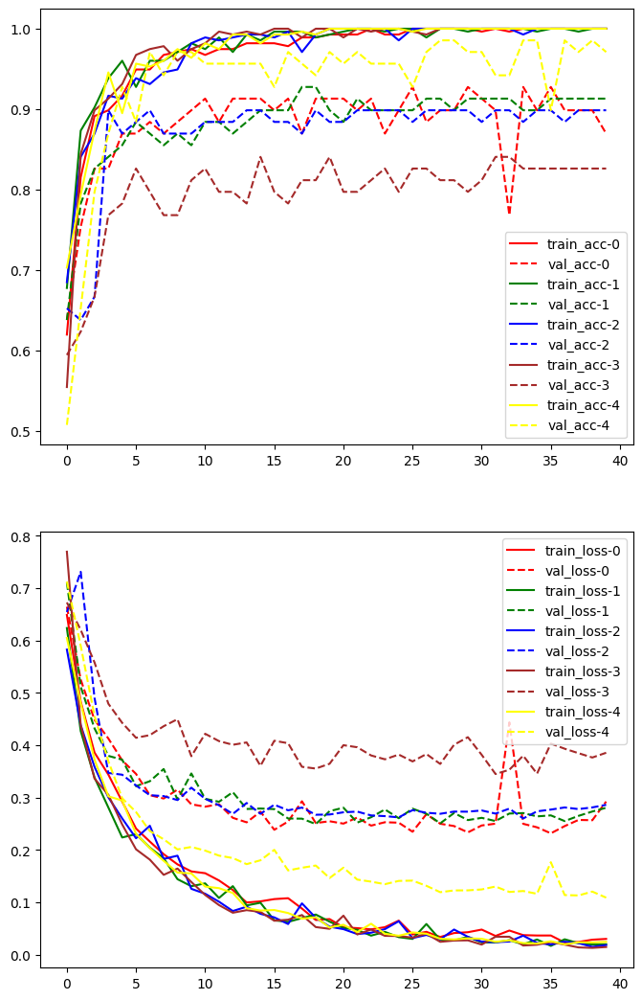

In [62]:
plot_histories(histories_resnet34, 'histories_resnet34')

In [80]:
df_histories_resnet34 = pd.DataFrame(columns = ['train_loss', 'val_loss', 'train_acc', 'val_acc'])

for history in histories_resnet34 :
  df_histories_resnet34 = pd.concat([df_histories_resnet34,history])

df_histories_resnet34.head()

,train_loss,val_loss,train_acc,val_acc
0,0.648692,0.664396,0.619565,0.637681
1,0.483283,0.525352,0.815217,0.753623
2,0.385856,0.448400,0.891304,0.826087
3,0.343849,0.412764,0.898551,0.826087
4,0.292375,0.371006,0.916667,0.869565


In [83]:
np.unique(df_histories_resnet34.index)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39])

In [84]:
df_histories_resnet34.to_csv('histories_resnet34.csv')

#### resnet50

In [64]:
model_resnet50 = models.resnet50(pretrained=True)
model_resnet50.fc = nn.Linear(in_features=2048, out_features=2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 217MB/s]


In [65]:
model_resnet50

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [66]:
fold_results = []

summary_resnet50 = pd.DataFrame(columns = ['train_acc' , 'val_acc'])
histories_resnet50 = []

for fold, (train_idx, test_idx) in enumerate(kfold.split(train_data)):
  print(f"Fold {fold + 1}")
  print("-------")

  train_loader = DataLoader(
      dataset=train_data,
      batch_size=32,
      sampler=torch.utils.data.SubsetRandomSampler(train_idx),
  )

  val_loader = DataLoader(
      dataset=train_data,
      batch_size=32,
      sampler=torch.utils.data.SubsetRandomSampler(test_idx),
  )

  model_resnet50 = models.resnet50(pretrained=True)
  model_resnet50.fc = nn.Linear(in_features=2048, out_features=2)

  cross_entropy = nn.CrossEntropyLoss()
  optimizer = torch.optim.SGD(model_resnet50.parameters() , lr=2e-3)


  histories_resnet50.append(train_model(model_resnet50, train_loader,val_loader,cross_entropy,optimizer,epochs))

  train_loss, train_acc = evaluate_model(model_resnet50, train_loader, cross_entropy)
  val_loss, val_acc = evaluate_model(model_resnet50,  val_loader, cross_entropy)

  print(f"train_loss: {train_loss} , val_loss: {val_loss}, train_acc: {train_acc}, val_acc: {val_acc}")
  summary_resnet50.loc[len(summary_resnet50.index)] = [train_acc , val_acc]

  fold_results.append(val_acc)

mean_accuracy = np.mean(fold_results)
print(f'\nMean Cross-Validation Accuracy: {mean_accuracy:.4f}')

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Fold 1
-------
True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6860125565874404, val_loss: 0.7233252127965292, train_acc: 0.5471014492753623, val_acc: 0.4492753623188406


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.5703570929126464, val_loss: 0.5513105513393015, train_acc: 0.8188405797101449, val_acc: 0.7391304347826086


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.5033550262451172, val_loss: 0.4876929659774338, train_acc: 0.8478260869565217, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.44989573178084, val_loss: 0.4254673805789671, train_acc: 0.8514492753623188, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.3929973758649135, val_loss: 0.42060243133185565, train_acc: 0.8985507246376812, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.3505814688793127, val_loss: 0.40461243537889013, train_acc: 0.9057971014492754, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.30646284507668536, val_loss: 0.3450794349546018, train_acc: 0.9094202898550725, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.29678759108419006, val_loss: 0.3407673218112061, train_acc: 0.9202898550724637, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.2472007481948189, val_loss: 0.3366607155488885, train_acc: 0.9420289855072463, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.24378166898437167, val_loss: 0.34931342066198157, train_acc: 0.9202898550724637, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.20069643898286682, val_loss: 0.2837432467419168, train_acc: 0.9637681159420289, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.19078555487204288, val_loss: 0.28950618617776513, train_acc: 0.9601449275362319, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.15869049727916718, val_loss: 0.29672426093315735, train_acc: 0.9710144927536232, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.18266564434853153, val_loss: 0.261119825684506, train_acc: 0.9565217391304348, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.1310400638891303, val_loss: 0.2536646613608236, train_acc: 0.9782608695652174, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.11769143675548444, val_loss: 0.253849971121636, train_acc: 0.9855072463768116, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.10979265989600748, val_loss: 0.23774980548499286, train_acc: 0.9891304347826086, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.09667804610470067, val_loss: 0.22866510394690692, train_acc: 0.9891304347826086, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.0902166089070016, val_loss: 0.2243102998405263, train_acc: 0.9891304347826086, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.0807040409333464, val_loss: 0.2275035606454248, train_acc: 0.9891304347826086, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.06872262568145558, val_loss: 0.2322173809659654, train_acc: 0.9927536231884058, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.06709914848856303, val_loss: 0.23382779750703037, train_acc: 0.9963768115942029, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.0667220983600271, val_loss: 0.24279349351274795, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.0786575066006702, val_loss: 0.2285600980554802, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.054680364503376724, val_loss: 0.22824256359667017, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.06483858138106871, val_loss: 0.21921672099742337, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.037004601750252906, val_loss: 0.21006296045970227, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.03493317567567895, val_loss: 0.20578716284986856, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.04837677751978239, val_loss: 0.21314952986827795, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.039941535317811416, val_loss: 0.21250409168609674, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.03704431242700936, val_loss: 0.19951362394984218, train_acc: 0.9963768115942029, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.03588629870311073, val_loss: 0.2115308552224567, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.03208323327851468, val_loss: 0.20029608106267624, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.029551138156566067, val_loss: 0.2318129053582316, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.035981475605048996, val_loss: 0.20765009160706963, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.025730196710513985, val_loss: 0.19954061815920082, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.021549282460540966, val_loss: 0.19785084931746774, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.022289311486309853, val_loss: 0.20891727960628012, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.028350214325431465, val_loss: 0.21327382974002673, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.021880708148945934, val_loss: 0.20884175447450168, train_acc: 1.0, val_acc: 0.9130434782608695
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.011698708613065706 , val_loss: 0.20883177652739096, train_acc: 1.0, val_acc: 0.9130434782608695
Fold 2
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.664065086323282, val_loss: 0.7524513429489689, train_acc: 0.6413043478260869, val_acc: 0.463768115942029


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.5589753138846245, val_loss: 0.609595921592436, train_acc: 0.7862318840579711, val_acc: 0.6376811594202898


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.4798053826974786, val_loss: 0.520905587984168, train_acc: 0.8623188405797102, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.42813995523729187, val_loss: 0.4754580069279325, train_acc: 0.8840579710144928, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.3761247478533482, val_loss: 0.4625401194544806, train_acc: 0.8840579710144928, val_acc: 0.7391304347826086


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.3271520595619644, val_loss: 0.42469970773959503, train_acc: 0.9094202898550725, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.3127410882625027, val_loss: 0.3927854355694591, train_acc: 0.927536231884058, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.24818945276564447, val_loss: 0.3726198586864748, train_acc: 0.9384057971014492, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.23541126907735632, val_loss: 0.3600200742915057, train_acc: 0.9456521739130435, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.23479720431825388, val_loss: 0.34888618234275043, train_acc: 0.9311594202898551, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.17860741740551547, val_loss: 0.3368498207866282, train_acc: 0.9782608695652174, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.1547250896692276, val_loss: 0.3162342677081841, train_acc: 0.9855072463768116, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.15160841440808945, val_loss: 0.3377524610014929, train_acc: 0.9746376811594203, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.12128802054170248, val_loss: 0.3316322202267854, train_acc: 0.9927536231884058, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.12471832291803499, val_loss: 0.3011790742908699, train_acc: 0.9782608695652174, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.10654236505860867, val_loss: 0.29536768642888556, train_acc: 0.9963768115942029, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.10016342554835306, val_loss: 0.30612776979156164, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.08553953900717307, val_loss: 0.30172755148099817, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.0736309054537096, val_loss: 0.3185400146505107, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.07182096042062926, val_loss: 0.29682505735452624, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.08475338430076405, val_loss: 0.32756458503612573, train_acc: 0.9891304347826086, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.05830944588650828, val_loss: 0.30211579151775525, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.04994899444821952, val_loss: 0.29158044206923334, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.051844793277374214, val_loss: 0.2813060127090717, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.058900649456874184, val_loss: 0.2886401065017866, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.06259193228206773, val_loss: 0.3016934394836426, train_acc: 0.9927536231884058, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.04865995913312055, val_loss: 0.2892105609610461, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.037103375716917755, val_loss: 0.28859498967295105, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.04267476153546485, val_loss: 0.27055717367624893, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.041113754329474075, val_loss: 0.30829129314077075, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.054976765228354416, val_loss: 0.33029811149058136, train_acc: 0.9927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.030387118458747864, val_loss: 0.29044065764848737, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.03147922337487124, val_loss: 0.2890506248543228, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.027679222271494244, val_loss: 0.2918639787729236, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.028765606005554615, val_loss: 0.29970687897740933, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.024370566253428875, val_loss: 0.2982634672274192, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.03427695267010426, val_loss: 0.29950921960930893, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.033256904478522316, val_loss: 0.28974421376335446, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.019314127933719883, val_loss: 0.3002345009126525, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.016162637783133465, val_loss: 0.3000484739524731, train_acc: 1.0, val_acc: 0.8985507246376812
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.010349873264414677 , val_loss: 0.30003609821416327, train_acc: 1.0, val_acc: 0.8985507246376812
Fold 3
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.684812585512797, val_loss: 0.672830575618191, train_acc: 0.5797101449275363, val_acc: 0.6231884057971014


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.5885833907818449, val_loss: 0.5810027087944142, train_acc: 0.717391304347826, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.51279858575351, val_loss: 0.521952508152395, train_acc: 0.8115942028985508, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.4571549106335294, val_loss: 0.4590817149998485, train_acc: 0.8731884057971014, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.4119512024133102, val_loss: 0.41391466752342554, train_acc: 0.855072463768116, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.3532988070577815, val_loss: 0.3866047055824943, train_acc: 0.9130434782608695, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.31881197336791217, val_loss: 0.3475231295046599, train_acc: 0.9021739130434783, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.2826681163000024, val_loss: 0.3193493861219157, train_acc: 0.9202898550724637, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.2558396380880605, val_loss: 0.30707325494807697, train_acc: 0.9311594202898551, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.22458650322927945, val_loss: 0.297852737100228, train_acc: 0.9601449275362319, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.20860567688941956, val_loss: 0.2890315711282302, train_acc: 0.9528985507246377, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.17340299940627554, val_loss: 0.2863507683294407, train_acc: 0.9637681159420289, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.17033887816512067, val_loss: 0.30590005024619726, train_acc: 0.9637681159420289, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.1457025844981705, val_loss: 0.282948286637016, train_acc: 0.9782608695652174, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.12862549700598785, val_loss: 0.2689944160157356, train_acc: 0.9782608695652174, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.11578593565070111, val_loss: 0.27247003357911453, train_acc: 0.9855072463768116, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.1114499281713928, val_loss: 0.26215151600215747, train_acc: 0.9855072463768116, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.09496327932330145, val_loss: 0.24527903127929437, train_acc: 0.9891304347826086, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.08815492279287698, val_loss: 0.2206437998059867, train_acc: 0.9855072463768116, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.07743688024904417, val_loss: 0.22641816540904666, train_acc: 0.9927536231884058, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.07878091132295305, val_loss: 0.2240062766317008, train_acc: 0.9891304347826086, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.08360013927238574, val_loss: 0.20791785046458244, train_acc: 0.9855072463768116, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.07794988484702249, val_loss: 0.24350663544475168, train_acc: 0.9891304347826086, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.07015700794864392, val_loss: 0.22225847278816113, train_acc: 0.9927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.05089372936366261, val_loss: 0.2256473946398583, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.05303698869934981, val_loss: 0.22748724921889926, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.05971133671161057, val_loss: 0.21429561272911404, train_acc: 0.9963768115942029, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.042614262713038406, val_loss: 0.21963075105694757, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.04169849889433902, val_loss: 0.24371481697628464, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.03802422655449397, val_loss: 0.21342733977497488, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.02935672756554424, val_loss: 0.25439940976059955, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.03537199916183085, val_loss: 0.21241221290783605, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.046740568202474846, val_loss: 0.21446852901599545, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.050671796651854034, val_loss: 0.19888940323954044, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.028394785831155983, val_loss: 0.19459435127783511, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.031017721239207447, val_loss: 0.22908046798429627, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.02135877573079821, val_loss: 0.2357688628245091, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.019678012400433636, val_loss: 0.202133071595344, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.0239346687398527, val_loss: 0.20585175355275473, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.023961522872897163, val_loss: 0.21878817931249522, train_acc: 1.0, val_acc: 0.8840579710144928
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.013603527125888977 , val_loss: 0.2187937772360401, train_acc: 1.0, val_acc: 0.8840579710144928
Fold 4
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6601237749707871, val_loss: 0.7491261017495308, train_acc: 0.6014492753623188, val_acc: 0.42028985507246375


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.5438452734463457, val_loss: 0.6940446832905645, train_acc: 0.8623188405797102, val_acc: 0.5797101449275363


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.46230999974236975, val_loss: 0.677340314872023, train_acc: 0.8768115942028986, val_acc: 0.6376811594202898


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.4190049940261288, val_loss: 0.6499050717422927, train_acc: 0.8840579710144928, val_acc: 0.6521739130434783


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.3713849817497143, val_loss: 0.5636031834975533, train_acc: 0.8876811594202898, val_acc: 0.7536231884057971


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.3293710661971051, val_loss: 0.5104518662328306, train_acc: 0.9021739130434783, val_acc: 0.7391304347826086


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.27542603706968005, val_loss: 0.47855157696682477, train_acc: 0.9528985507246377, val_acc: 0.7536231884057971


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.24016432917636374, val_loss: 0.48769834292107733, train_acc: 0.9492753623188406, val_acc: 0.7536231884057971


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.24606754339259604, val_loss: 0.49496877452601556, train_acc: 0.9384057971014492, val_acc: 0.7391304347826086


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.19222370221994925, val_loss: 0.453976287358049, train_acc: 0.9528985507246377, val_acc: 0.7536231884057971


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.16482345533111822, val_loss: 0.44477298812589783, train_acc: 0.9891304347826086, val_acc: 0.7246376811594203


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.17196827543818433, val_loss: 0.4532940197682035, train_acc: 0.9637681159420289, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.14898971219857535, val_loss: 0.4113752913215886, train_acc: 0.9710144927536232, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.12009078167054964, val_loss: 0.3991509300211202, train_acc: 0.9818840579710145, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.1056285465973011, val_loss: 0.4312772992728413, train_acc: 0.9891304347826086, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.10633694650470346, val_loss: 0.40823516465615534, train_acc: 0.9855072463768116, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.09887652833392654, val_loss: 0.39679412219835364, train_acc: 0.9855072463768116, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.08157633763292561, val_loss: 0.3837082800657853, train_acc: 0.9891304347826086, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.07300615715591804, val_loss: 0.3813283162704412, train_acc: 0.9927536231884058, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.07432059878888338, val_loss: 0.41127430485642474, train_acc: 0.9927536231884058, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.0782786877690882, val_loss: 0.438121964102206, train_acc: 0.9927536231884058, val_acc: 0.7536231884057971


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.061676328218933464, val_loss: 0.43117841948633606, train_acc: 0.9927536231884058, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.06134555348451587, val_loss: 0.4016604045594948, train_acc: 0.9927536231884058, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.049069585845522255, val_loss: 0.39321153708126233, train_acc: 0.9927536231884058, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.05724279021007427, val_loss: 0.399139984794285, train_acc: 0.9927536231884058, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.041091650670421295, val_loss: 0.4037343341371287, train_acc: 0.9927536231884058, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.04426495925239895, val_loss: 0.3932467310324959, train_acc: 0.9927536231884058, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.0420136666600255, val_loss: 0.38946084008700604, train_acc: 0.9927536231884058, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.03951990561208863, val_loss: 0.3868226676747419, train_acc: 0.9927536231884058, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.035772007552609925, val_loss: 0.42342006814652594, train_acc: 0.9927536231884058, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.03638521198561226, val_loss: 0.3934321861336197, train_acc: 0.9963768115942029, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.035212628003479775, val_loss: 0.3828665445680204, train_acc: 0.9963768115942029, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.03039127809629924, val_loss: 0.4065023256816726, train_acc: 0.9927536231884058, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.03653819162560546, val_loss: 0.3914274357367253, train_acc: 1.0, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.030904106660813526, val_loss: 0.41155654256758484, train_acc: 0.9963768115942029, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.02443835239155569, val_loss: 0.39858211728109827, train_acc: 0.9963768115942029, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.030937885946553688, val_loss: 0.38638883915500366, train_acc: 1.0, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.019866990681359734, val_loss: 0.3987553370171699, train_acc: 1.0, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.023856126581845077, val_loss: 0.42340654393900995, train_acc: 1.0, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.01768194946149985, val_loss: 0.4004161509050839, train_acc: 1.0, val_acc: 0.8115942028985508
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.013444017429930576 , val_loss: 0.40042499253067415, train_acc: 1.0, val_acc: 0.8115942028985508
Fold 5
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6601700247197911, val_loss: 0.7026944212291552, train_acc: 0.6557971014492754, val_acc: 0.4927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.5689413867134979, val_loss: 0.6584038026090981, train_acc: 0.7644927536231884, val_acc: 0.5652173913043478


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.5011090316634247, val_loss: 0.49714558884717414, train_acc: 0.8043478260869565, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.4475375025168709, val_loss: 0.45284114497295325, train_acc: 0.855072463768116, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.4016419994658318, val_loss: 0.403854761434638, train_acc: 0.8876811594202898, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.34651367258334503, val_loss: 0.3738328831783239, train_acc: 0.9202898550724637, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.3089788996655008, val_loss: 0.3182089786598648, train_acc: 0.9347826086956522, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.3029936789602473, val_loss: 0.3258331046588179, train_acc: 0.9094202898550725, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.25695862329524494, val_loss: 0.26508295514445374, train_acc: 0.9420289855072463, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.2375741808310799, val_loss: 0.2616791167984838, train_acc: 0.9311594202898551, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.19487793030946152, val_loss: 0.25927330186401587, train_acc: 0.9637681159420289, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.17753837052462756, val_loss: 0.23977569523064987, train_acc: 0.9746376811594203, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.15619748139726944, val_loss: 0.24275080708489902, train_acc: 0.9710144927536232, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.13065937139849731, val_loss: 0.2230994843918344, train_acc: 0.9855072463768116, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.13682580944420636, val_loss: 0.21772324866142825, train_acc: 0.967391304347826, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.11220411740351414, val_loss: 0.23849772629530533, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.09922009371760962, val_loss: 0.20152413240377454, train_acc: 0.9855072463768116, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.10477333677851636, val_loss: 0.21152893205483755, train_acc: 0.9855072463768116, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.08202730248803677, val_loss: 0.19353068695552106, train_acc: 0.9891304347826086, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.08121174552302429, val_loss: 0.1854739897493003, train_acc: 0.9891304347826086, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.08513878653014915, val_loss: 0.20513320336307306, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.1257335620297902, val_loss: 0.18262266702410104, train_acc: 0.9818840579710145, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.05481392544680747, val_loss: 0.17974610389142798, train_acc: 0.9927536231884058, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.05489291952572007, val_loss: 0.1814903869577076, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.06458438565765602, val_loss: 0.17322256102942038, train_acc: 0.9891304347826086, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.04107337971420392, val_loss: 0.17547925734433575, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.057029881663080574, val_loss: 0.17088119102560956, train_acc: 0.9927536231884058, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.045239909079627716, val_loss: 0.17653063074618147, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.04099786216798036, val_loss: 0.18209132185016852, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.03147970064394716, val_loss: 0.16598516465097235, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.031527192048404526, val_loss: 0.1611596803734268, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.05427155325162238, val_loss: 0.16683528108009393, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.03115018114339614, val_loss: 0.15794055009989635, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.029227234207201695, val_loss: 0.16027009433162384, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.02449423807632664, val_loss: 0.1619633109835179, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.02718944631624913, val_loss: 0.15509065424186597, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.03516987835367521, val_loss: 0.14966526503364244, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.022744822923256004, val_loss: 0.1474611318629721, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.030584074664806973, val_loss: 0.16046312219206837, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.022193032438340393, val_loss: 0.15076737580955893, train_acc: 1.0, val_acc: 0.927536231884058
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.012217655561972355 , val_loss: 0.15076963398335635, train_acc: 1.0, val_acc: 0.927536231884058

Mean Cross-Validation Accuracy: 0.8870


In [67]:
summary_resnet50

,train_acc,val_acc
0,1.0,0.913043
1,1.0,0.898551
2,1.0,0.884058
3,1.0,0.811594
4,1.0,0.927536


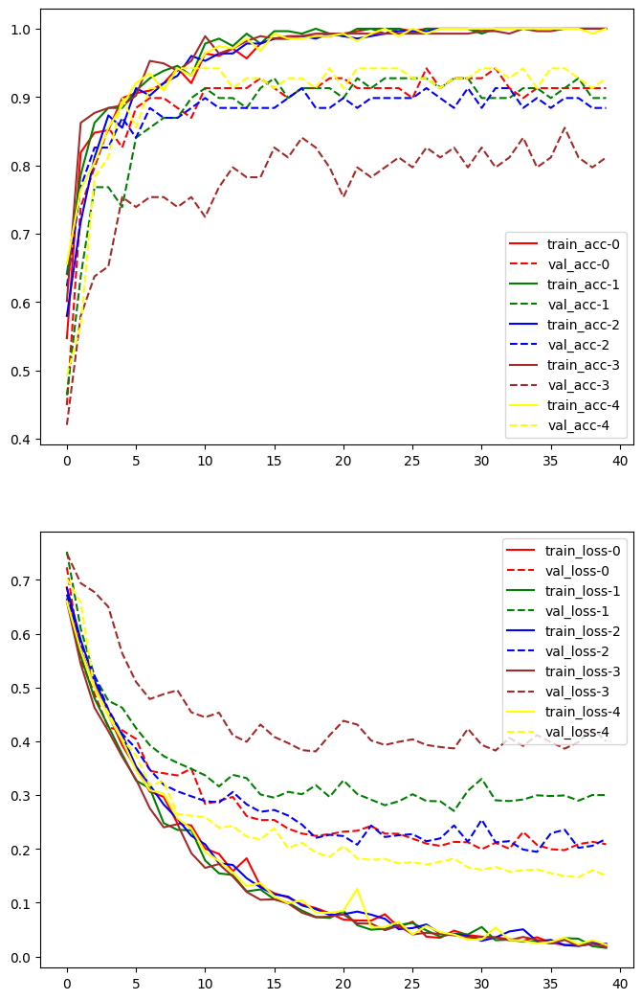

In [68]:
plot_histories(histories_resnet50, 'histories_resnet50')

In [85]:
df_histories_resnet50 = pd.DataFrame(columns = ['train_loss', 'val_loss', 'train_acc', 'val_acc'])

for history in histories_resnet50 :
  df_histories_resnet50 = pd.concat([df_histories_resnet50,history])

df_histories_resnet50.to_csv('histories_resnet50.csv')

#### densenet121

In [70]:
model_densenet121 = models.densenet121(pretrained=True)
model_densenet121.classifier = nn.Linear(in_features=1024, out_features=2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 195MB/s]


In [71]:
model_densenet121

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

In [72]:
fold_results = []

summary_densenet121 = pd.DataFrame(columns = ['train_acc' , 'val_acc'])
histories_densenet121 = []

for fold, (train_idx, test_idx) in enumerate(kfold.split(train_data)):
  print(f"Fold {fold + 1}")
  print("-------")

  train_loader = DataLoader(
      dataset=train_data,
      batch_size=32,
      sampler=torch.utils.data.SubsetRandomSampler(train_idx),
  )

  val_loader = DataLoader(
      dataset=train_data,
      batch_size=32,
      sampler=torch.utils.data.SubsetRandomSampler(test_idx),
  )

  model_densenet121 = models.densenet121(pretrained=True)
  model_densenet121.classifier = nn.Linear(in_features=1024, out_features=2)

  cross_entropy = nn.CrossEntropyLoss()
  optimizer = torch.optim.SGD(model_densenet121.parameters() , lr=2e-3)


  histories_densenet121.append(train_model(model_densenet121, train_loader,val_loader,cross_entropy,optimizer,epochs))

  train_loss, train_acc = evaluate_model(model_densenet121, train_loader, cross_entropy)
  val_loss, val_acc = evaluate_model(model_densenet121,  val_loader, cross_entropy)

  print(f"train_loss: {train_loss} , val_loss: {val_loss}, train_acc: {train_acc}, val_acc: {val_acc}")
  summary_densenet121.loc[len(summary_densenet121.index)] = [train_acc , val_acc]

  fold_results.append(val_acc)

mean_accuracy = np.mean(fold_results)
print(f'\nMean Cross-Validation Accuracy: {mean_accuracy:.4f}')

Fold 1
-------
True


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6569561491841855, val_loss: 0.607047010159147, train_acc: 0.6376811594202898, val_acc: 0.7536231884057971


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.49482245462528174, val_loss: 0.5426987487336864, train_acc: 0.8586956521739131, val_acc: 0.6811594202898551


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.4134257081626118, val_loss: 0.4380968688190847, train_acc: 0.8731884057971014, val_acc: 0.7536231884057971


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.35128469484439795, val_loss: 0.40468901525373047, train_acc: 0.9311594202898551, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.30795824441356934, val_loss: 0.3838663209175718, train_acc: 0.9130434782608695, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.28512149422928906, val_loss: 0.3510656644036804, train_acc: 0.9384057971014492, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.2365971579067949, val_loss: 0.3442844800327135, train_acc: 0.9420289855072463, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.2411243660726409, val_loss: 0.321760400481846, train_acc: 0.9239130434782609, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.19852460467297098, val_loss: 0.3033884703249171, train_acc: 0.9456521739130435, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.1778032829364141, val_loss: 0.3007356982300247, train_acc: 0.967391304347826, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.1620718974998032, val_loss: 0.28334183105524036, train_acc: 0.967391304347826, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.1345327390708785, val_loss: 0.3096066041701082, train_acc: 0.9818840579710145, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.15048912167549133, val_loss: 0.26365311551785126, train_acc: 0.9746376811594203, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.10874551491460939, val_loss: 0.26648537879404816, train_acc: 0.9891304347826086, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.1169500296962434, val_loss: 0.26117672943982523, train_acc: 0.9891304347826086, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.08997086122416068, val_loss: 0.24735060550164487, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.11115528675525085, val_loss: 0.2554373702277308, train_acc: 0.9818840579710145, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.0789766439061234, val_loss: 0.2568065073827039, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.06472978632951128, val_loss: 0.2469858125500057, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.06722821522018184, val_loss: 0.2425589041001555, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.08464190471863402, val_loss: 0.2348236588464267, train_acc: 0.9782608695652174, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.09109477461248204, val_loss: 0.3032614705355271, train_acc: 0.9891304347826086, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.05538273672910704, val_loss: 0.22003048226453256, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.0645828554811685, val_loss: 0.23178017679331958, train_acc: 0.9927536231884058, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.04088376062935677, val_loss: 0.2555711184074913, train_acc: 1.0, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.06265085514472879, val_loss: 0.2240715061948783, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.04977848877509435, val_loss: 0.22986700310223346, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.05318017206762148, val_loss: 0.2182304422924484, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.04117139439651932, val_loss: 0.21792620787585992, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.03425862219022668, val_loss: 0.23323328274747598, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.04232475042775057, val_loss: 0.2258190940255704, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.05074025539384372, val_loss: 0.24382394541432892, train_acc: 0.9927536231884058, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.039951974283093994, val_loss: 0.22284481318100638, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.029431217552527138, val_loss: 0.224904656464207, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.029264415708788925, val_loss: 0.218965207591005, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.02657804765023183, val_loss: 0.22018200094285217, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.021002703143850616, val_loss: 0.21013699647417103, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.02947563184020312, val_loss: 0.2082545969473279, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.02147417820558168, val_loss: 0.21028589570651884, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.0278643147237059, val_loss: 0.21730065280976502, train_acc: 1.0, val_acc: 0.927536231884058
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.018090275075772533 , val_loss: 0.2172938424392023, train_acc: 1.0, val_acc: 0.927536231884058
Fold 2
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6139351475066033, val_loss: 0.6841674377952797, train_acc: 0.6666666666666666, val_acc: 0.5797101449275363


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.4748746018478836, val_loss: 0.5757072403811027, train_acc: 0.8405797101449275, val_acc: 0.6666666666666666


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.4035544248594754, val_loss: 0.5022410456685052, train_acc: 0.855072463768116, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.3453187972739123, val_loss: 0.45825644809266797, train_acc: 0.9094202898550725, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.29371459717335907, val_loss: 0.42676859834919806, train_acc: 0.927536231884058, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.26776854585910187, val_loss: 0.39221387496892957, train_acc: 0.9384057971014492, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.270002995280252, val_loss: 0.3859630060800608, train_acc: 0.8913043478260869, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.19489718822465427, val_loss: 0.3708387643530749, train_acc: 0.967391304347826, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.1958211250063302, val_loss: 0.35090089967285376, train_acc: 0.9601449275362319, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.16213503609532895, val_loss: 0.3654886181803717, train_acc: 0.9818840579710145, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.14734055965706921, val_loss: 0.34766694557839545, train_acc: 0.9891304347826086, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.14450065942778104, val_loss: 0.3459908798121024, train_acc: 0.9818840579710145, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.12755898720976236, val_loss: 0.3391836881637573, train_acc: 0.9782608695652174, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.1409089357956596, val_loss: 0.33277649032896844, train_acc: 0.9782608695652174, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.0996558677027191, val_loss: 0.3565120005953139, train_acc: 0.9963768115942029, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.08525174899377684, val_loss: 0.30651438409003656, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.0846859994681849, val_loss: 0.3058075403821641, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.08910975200326546, val_loss: 0.32550320720327075, train_acc: 0.9927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.10144069531689519, val_loss: 0.32305529843205993, train_acc: 0.9782608695652174, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.06543682542616043, val_loss: 0.30276604493459064, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.05429585256438325, val_loss: 0.2939397312592769, train_acc: 0.9963768115942029, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.07115095648644627, val_loss: 0.3033834367558576, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.05141067753235499, val_loss: 0.3028457812640978, train_acc: 0.9963768115942029, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.06011843821708707, val_loss: 0.3054514384788016, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.07780195934617001, val_loss: 0.3295995480772378, train_acc: 0.9855072463768116, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.03826092296968336, val_loss: 0.2941889849261961, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.03418689998595611, val_loss: 0.29805799411690753, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.06041680017243261, val_loss: 0.2913183491083159, train_acc: 0.9891304347826086, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.0371989540323831, val_loss: 0.2866000443481017, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.028759297955295315, val_loss: 0.2877610857072084, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.040210853668226715, val_loss: 0.3243489852849988, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.03784362925891427, val_loss: 0.292476045264714, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.0310351031737915, val_loss: 0.3032871618650962, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.029498837078395096, val_loss: 0.29281484389650647, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.02929457503816356, val_loss: 0.29842481513818103, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.02170721484699111, val_loss: 0.29472492548866547, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.026805408244979553, val_loss: 0.29551457192586816, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.019007071609730305, val_loss: 0.296114649893581, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.0289786406185316, val_loss: 0.30428475724614185, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.023631754236808723, val_loss: 0.30064612540645874, train_acc: 1.0, val_acc: 0.927536231884058
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.012957401114745417 , val_loss: 0.30067088854485663, train_acc: 1.0, val_acc: 0.927536231884058
Fold 3
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.676393417344577, val_loss: 0.676704498304837, train_acc: 0.5797101449275363, val_acc: 0.5797101449275363


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.5313239831855332, val_loss: 0.5517841119697129, train_acc: 0.7971014492753623, val_acc: 0.7391304347826086


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.4399959134018939, val_loss: 0.4499003049256145, train_acc: 0.8876811594202898, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.3781311727952266, val_loss: 0.4261892040570577, train_acc: 0.8985507246376812, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.32916289481563843, val_loss: 0.3714844681646513, train_acc: 0.9239130434782609, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.3023260322169981, val_loss: 0.36341677238975745, train_acc: 0.927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.26847591564275214, val_loss: 0.3140175990436388, train_acc: 0.9637681159420289, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.22386957381082617, val_loss: 0.31716578550960706, train_acc: 0.9601449275362319, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.2409703722898511, val_loss: 0.31497741307037463, train_acc: 0.9456521739130435, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.20663112574729367, val_loss: 0.40710253689600073, train_acc: 0.9565217391304348, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.1704972321572511, val_loss: 0.27720858869345294, train_acc: 0.9746376811594203, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.15836191566094107, val_loss: 0.25492052301980445, train_acc: 0.967391304347826, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.15452900312948917, val_loss: 0.29680794952572254, train_acc: 0.9746376811594203, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.15149481896904932, val_loss: 0.34715376567581424, train_acc: 0.9710144927536232, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.13079200674226318, val_loss: 0.24013080026792444, train_acc: 0.9818840579710145, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.11680005080458047, val_loss: 0.22346999010314111, train_acc: 0.9855072463768116, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.09621878097886624, val_loss: 0.2475280254215434, train_acc: 0.9855072463768116, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.09025516134241353, val_loss: 0.22607569266920505, train_acc: 0.9855072463768116, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.08801094939311345, val_loss: 0.23443730542625207, train_acc: 0.9855072463768116, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.07703203891498456, val_loss: 0.2285032368440559, train_acc: 0.9891304347826086, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.09295315500618755, val_loss: 0.23335914211212724, train_acc: 0.9746376811594203, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.07220295292959697, val_loss: 0.2149770447741384, train_acc: 0.9927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.068161406594774, val_loss: 0.24311905300271683, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.07034310223399728, val_loss: 0.2148231345674266, train_acc: 0.9891304347826086, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.053318118703538094, val_loss: 0.22050789128179135, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.05053475644925366, val_loss: 0.21733976295892743, train_acc: 0.9927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.058135157262069595, val_loss: 0.21078961828480597, train_acc: 0.9963768115942029, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.05472172386404397, val_loss: 0.2109605081487393, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.04239342080942099, val_loss: 0.21929488709007483, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.0472045121849447, val_loss: 0.20258926735192107, train_acc: 0.9963768115942029, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.049135147499433464, val_loss: 0.21015949374523715, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.040621579071317894, val_loss: 0.22177133914353192, train_acc: 0.9963768115942029, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.054681072200554, val_loss: 0.19920557780542236, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.04042852891312129, val_loss: 0.20302434071250583, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.032672105869953186, val_loss: 0.2310459517698357, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.02918141070699346, val_loss: 0.1947799795779629, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.0334802247799825, val_loss: 0.2051529302329257, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.03344163622545159, val_loss: 0.18648451134778452, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.030211879993262497, val_loss: 0.1894340169602546, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.033083954394079636, val_loss: 0.20964418972531954, train_acc: 1.0, val_acc: 0.8985507246376812
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.018150323988410873 , val_loss: 0.20964604594569275, train_acc: 1.0, val_acc: 0.8985507246376812
Fold 4
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6781336587408314, val_loss: 0.7256904313529747, train_acc: 0.5688405797101449, val_acc: 0.5072463768115942


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.505906765875609, val_loss: 0.608299061871957, train_acc: 0.8514492753623188, val_acc: 0.6956521739130435


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.420862867348436, val_loss: 0.5520923794179723, train_acc: 0.8804347826086957, val_acc: 0.7246376811594203


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.34610376453054126, val_loss: 0.5298786180606787, train_acc: 0.927536231884058, val_acc: 0.7391304347826086


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.30871383781018463, val_loss: 0.48959661177966907, train_acc: 0.9347826086956522, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.2819253867087157, val_loss: 0.41769210929455963, train_acc: 0.9347826086956522, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.2334096634733504, val_loss: 0.4329941704653312, train_acc: 0.967391304347826, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.21647591305815655, val_loss: 0.42255307604437287, train_acc: 0.9601449275362319, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.17941284158091614, val_loss: 0.4239788608274598, train_acc: 0.967391304347826, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.18689015226951544, val_loss: 0.3822143486012583, train_acc: 0.9637681159420289, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.16278862218925919, val_loss: 0.3991061025771542, train_acc: 0.9710144927536232, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.14320644023625748, val_loss: 0.38069323612296063, train_acc: 0.9710144927536232, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.1303709866344065, val_loss: 0.35984808897626575, train_acc: 0.9891304347826086, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.12415330867836441, val_loss: 0.33146235001259955, train_acc: 0.9855072463768116, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.10620037001976068, val_loss: 0.34726372577142023, train_acc: 0.9855072463768116, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.1288547591454741, val_loss: 0.3241410069707511, train_acc: 0.9746376811594203, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.10189891077470088, val_loss: 0.35644377638464386, train_acc: 0.9818840579710145, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.07903077874494635, val_loss: 0.3377714558787968, train_acc: 0.9891304347826086, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.0842497582020967, val_loss: 0.3251448921535326, train_acc: 0.9855072463768116, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.06773681787477023, val_loss: 0.3299696376358253, train_acc: 0.9963768115942029, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.05965260977762333, val_loss: 0.31646205808805383, train_acc: 0.9891304347826086, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.0658459736817125, val_loss: 0.31732455198315607, train_acc: 0.9927536231884058, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.058224948743979134, val_loss: 0.3126067156377046, train_acc: 0.9891304347826086, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.049823315571183746, val_loss: 0.30291670128919074, train_acc: 0.9963768115942029, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.055006895808206085, val_loss: 0.34347756358160486, train_acc: 1.0, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.04263828856789548, val_loss: 0.3163690579974133, train_acc: 1.0, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.04528642850725547, val_loss: 0.3014332824859066, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.05693873082814009, val_loss: 0.29942175961922907, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.046197425951992256, val_loss: 0.2971107242763906, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.04324577273665995, val_loss: 0.29060687491859216, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.05410221629384635, val_loss: 0.3164561601976554, train_acc: 0.9963768115942029, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.037513150361137115, val_loss: 0.311039330518764, train_acc: 1.0, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.030847685600536457, val_loss: 0.3140704952504324, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.03224762799083323, val_loss: 0.2850234858367754, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.027603704752265545, val_loss: 0.2947052518526713, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.035075990888087646, val_loss: 0.30420923492182855, train_acc: 1.0, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.023610311870773632, val_loss: 0.29819354026213934, train_acc: 1.0, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.03055253473744876, val_loss: 0.2895087020984594, train_acc: 1.0, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.019910894010377968, val_loss: 0.2874852643496748, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.03146666639308999, val_loss: 0.2945655437483304, train_acc: 1.0, val_acc: 0.8695652173913043
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.016141444309682087 , val_loss: 0.294563038625579, train_acc: 1.0, val_acc: 0.8695652173913043
Fold 5
-------
True


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6456313686094423, val_loss: 0.6236904816351075, train_acc: 0.6123188405797102, val_acc: 0.5362318840579711


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.48534716384998267, val_loss: 0.5312641599903936, train_acc: 0.8478260869565217, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.4259136383948119, val_loss: 0.483406401630761, train_acc: 0.855072463768116, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.36275838769000507, val_loss: 0.4100469368091528, train_acc: 0.9021739130434783, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.31402043847070227, val_loss: 0.37826924825060193, train_acc: 0.9166666666666666, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.2903074483940567, val_loss: 0.3305043411859568, train_acc: 0.927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.27986903294273047, val_loss: 0.3314725735049317, train_acc: 0.9202898550724637, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.23155101637045541, val_loss: 0.27152875886447186, train_acc: 0.9384057971014492, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.22252467965734177, val_loss: 0.27366028143012006, train_acc: 0.9528985507246377, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.19433134513488715, val_loss: 0.24575444926386295, train_acc: 0.9601449275362319, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.16934704478236212, val_loss: 0.2571726994238038, train_acc: 0.967391304347826, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.15577583544064258, val_loss: 0.21617631020321362, train_acc: 0.9746376811594203, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.1670195274594901, val_loss: 0.23005386755086374, train_acc: 0.967391304347826, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.13656252579412598, val_loss: 0.19985846181710562, train_acc: 0.9746376811594203, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.14826141492180203, val_loss: 0.18936524162257928, train_acc: 0.9710144927536232, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.14000316676886185, val_loss: 0.19288669710142026, train_acc: 0.9746376811594203, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.1278823538534883, val_loss: 0.1823846310161162, train_acc: 0.9855072463768116, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.10273171680561011, val_loss: 0.19417291490927988, train_acc: 0.9855072463768116, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.08815784115290297, val_loss: 0.170290254380392, train_acc: 0.9963768115942029, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.08364835057569586, val_loss: 0.16751103394705316, train_acc: 0.9927536231884058, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.08750154045612915, val_loss: 0.16247424396915713, train_acc: 0.9891304347826086, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.07373615645844003, val_loss: 0.15748088796069656, train_acc: 0.9963768115942029, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.07288555876500365, val_loss: 0.15543788131596387, train_acc: 0.9927536231884058, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.06663748621940613, val_loss: 0.1655171547031057, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.055021705618803055, val_loss: 0.14962486944336822, train_acc: 0.9963768115942029, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.06592351241388182, val_loss: 0.15261780546195264, train_acc: 0.9927536231884058, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.05606738078421441, val_loss: 0.14705095996243367, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.0628297901239948, val_loss: 0.15525777659554413, train_acc: 0.9963768115942029, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.06071867361880731, val_loss: 0.14484554745148923, train_acc: 1.0, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.039922031263510384, val_loss: 0.1397393114756847, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.047799724923527756, val_loss: 0.14883195090553034, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.051487030920343124, val_loss: 0.14092987549045813, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.037058554940681526, val_loss: 0.13523242938453736, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.037191279340481415, val_loss: 0.13536168348746022, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.03505355057617029, val_loss: 0.13432811610940573, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.030115926395291866, val_loss: 0.13211286869709907, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.029231513323991196, val_loss: 0.1445077579954396, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.03184997970643251, val_loss: 0.12356192175892816, train_acc: 1.0, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.029529580819434013, val_loss: 0.12182264310726221, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.02764571463500244, val_loss: 0.12275112636279369, train_acc: 1.0, val_acc: 0.9565217391304348
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.017085666268847992 , val_loss: 0.12274642048430616, train_acc: 1.0, val_acc: 0.9565217391304348

Mean Cross-Validation Accuracy: 0.9159


In [73]:
summary_densenet121

,train_acc,val_acc
0,1.0,0.927536
1,1.0,0.927536
2,1.0,0.898551
3,1.0,0.869565
4,1.0,0.956522


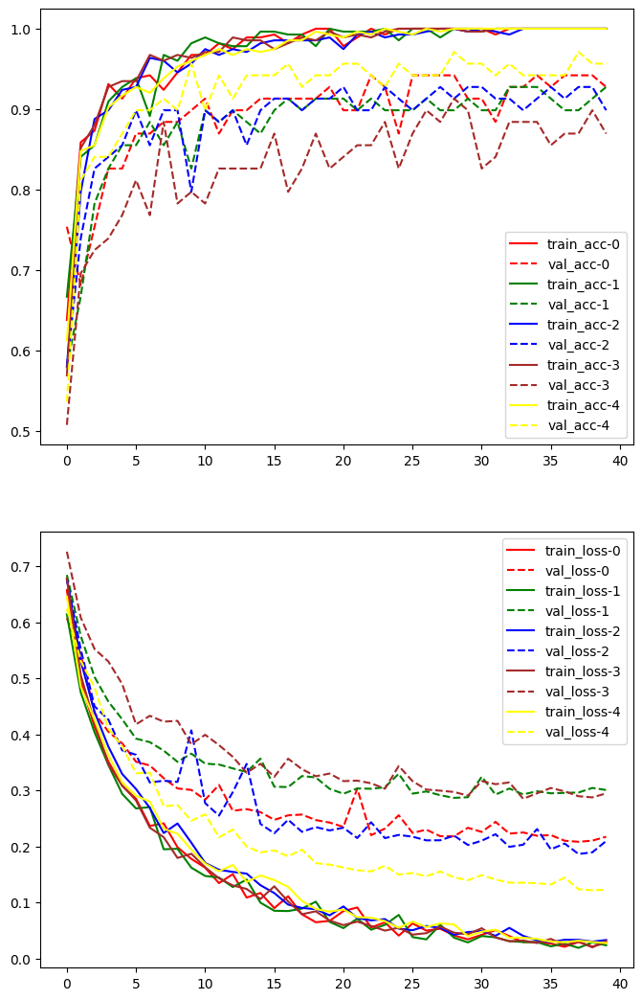

In [74]:
plot_histories(histories_densenet121,'histories densenet121')

In [86]:
df_histories_densenet121 = pd.DataFrame(columns = ['train_loss', 'val_loss', 'train_acc', 'val_acc'])

for history in histories_densenet121 :
  df_histories_densenet121 = pd.concat([df_histories_densenet121,history])

df_histories_densenet121.to_csv('histories_densenet121.csv')

#### densenet201

In [28]:
model_densenet201 = models.densenet201(pretrained=True)
model_densenet201.classifier = nn.Linear(in_features=1920 , out_features=2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet201_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet201_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet201-c1103571.pth" to /root/.cache/torch/hub/checkpoints/densenet201-c1103571.pth
100%|██████████| 77.4M/77.4M [00:00<00:00, 216MB/s]


In [29]:
model_densenet201

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

In [30]:
fold_results = []

summary_densenet201 = pd.DataFrame(columns = ['train_acc' , 'val_acc'])
histories_densenet201 = []

for fold, (train_idx, test_idx) in enumerate(kfold.split(train_data)):
  print(f"Fold {fold + 1}")
  print("-------")

  train_loader = DataLoader(
      dataset=train_data,
      batch_size=32,
      sampler=torch.utils.data.SubsetRandomSampler(train_idx),
  )

  val_loader = DataLoader(
      dataset=train_data,
      batch_size=32,
      sampler=torch.utils.data.SubsetRandomSampler(test_idx),
  )

  model_densenet201 = models.densenet201(pretrained=True)
  model_densenet201.classifier = nn.Linear(in_features=1920, out_features=2)

  cross_entropy = nn.CrossEntropyLoss()
  optimizer = torch.optim.SGD(model_densenet201.parameters() , lr=2e-3)


  histories_densenet201.append(train_model(model_densenet201, train_loader,val_loader,cross_entropy,optimizer,epochs))

  train_loss, train_acc = evaluate_model(model_densenet201, train_loader, cross_entropy)
  val_loss, val_acc = evaluate_model(model_densenet201,  val_loader, cross_entropy)

  print(f"train_loss: {train_loss} , val_loss: {val_loss}, train_acc: {train_acc}, val_acc: {val_acc}")
  summary_densenet201.loc[len(summary_densenet201.index)] = [train_acc , val_acc]

  fold_results.append(val_acc)

mean_accuracy = np.mean(fold_results)
print(f'\nMean Cross-Validation Accuracy: {mean_accuracy:.4f}')

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet201_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet201_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Fold 1
-------
True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6699085736620254, val_loss: 0.6930638983629752, train_acc: 0.5869565217391305, val_acc: 0.4782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.5199696067450703, val_loss: 0.6206528363020524, train_acc: 0.8333333333333334, val_acc: 0.6666666666666666


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.4359850019648455, val_loss: 0.5306499531303627, train_acc: 0.8804347826086957, val_acc: 0.7536231884057971


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.3752804752709209, val_loss: 0.4802503516708595, train_acc: 0.9094202898550725, val_acc: 0.7391304347826086


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.3289142069609269, val_loss: 0.42330307718636334, train_acc: 0.9166666666666666, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.2958463918471682, val_loss: 0.3964836187120797, train_acc: 0.9239130434782609, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.27752722540627356, val_loss: 0.3270929598289987, train_acc: 0.9347826086956522, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.24124849749648053, val_loss: 0.33893933373948804, train_acc: 0.9239130434782609, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.20070802280004474, val_loss: 0.29266985106295434, train_acc: 0.9492753623188406, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.18884950660277103, val_loss: 0.29272010533706, train_acc: 0.9456521739130435, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.18002792415411575, val_loss: 0.29072312665158423, train_acc: 0.9601449275362319, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.16681868334611258, val_loss: 0.27491364973610727, train_acc: 0.9601449275362319, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.13664156349672787, val_loss: 0.2504952813404194, train_acc: 0.967391304347826, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.12089329104924547, val_loss: 0.2685709425072739, train_acc: 0.9891304347826086, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.11065056963243346, val_loss: 0.2398710328599681, train_acc: 0.9782608695652174, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.11745287531959837, val_loss: 0.2603334140950355, train_acc: 0.9746376811594203, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.11743930219740108, val_loss: 0.24197610003360803, train_acc: 0.9855072463768116, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.07959489599950072, val_loss: 0.2224288099053977, train_acc: 0.9963768115942029, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.07641728989024094, val_loss: 0.23915936355141626, train_acc: 0.9963768115942029, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.07796259883089342, val_loss: 0.21853493143250977, train_acc: 0.9927536231884058, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.07141523527494376, val_loss: 0.22652441263198853, train_acc: 0.9891304347826086, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.07034166977889296, val_loss: 0.2489298297011334, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.06801289098634236, val_loss: 0.21114682719327402, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.049973508909992546, val_loss: 0.21485521827918896, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.049866014740605286, val_loss: 0.20967663263065228, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.05034616146830545, val_loss: 0.21004477618397147, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.04280942019777022, val_loss: 0.2295976294123608, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.04407121111517367, val_loss: 0.21845911194880804, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.03895720839500427, val_loss: 0.20795951448920844, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.03910909884649774, val_loss: 0.19508822899365771, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.04942511375723542, val_loss: 0.19563736237477566, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.03733043145874272, val_loss: 0.20179944884949835, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.028787279150624207, val_loss: 0.20058940523776456, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.02620184397243935, val_loss: 0.20360835760399915, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.026904566024524578, val_loss: 0.20736619549385016, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.027569091082483097, val_loss: 0.1999386393505594, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.03210255158120307, val_loss: 0.19508518688920615, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.026573888957500458, val_loss: 0.20249191120914792, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.034669548597024834, val_loss: 0.2058831649845925, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.020290868005890778, val_loss: 0.19050241639648657, train_acc: 1.0, val_acc: 0.9420289855072463
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.014495532028377056 , val_loss: 0.19051283074245937, train_acc: 1.0, val_acc: 0.9420289855072463
Fold 2
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet201_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet201_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6606818308000979, val_loss: 0.7040607531865438, train_acc: 0.605072463768116, val_acc: 0.5072463768115942


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.5226087047569994, val_loss: 0.6184395672618479, train_acc: 0.7971014492753623, val_acc: 0.7246376811594203


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.444903159055157, val_loss: 0.5748949957930524, train_acc: 0.855072463768116, val_acc: 0.7101449275362319


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.37697365750437195, val_loss: 0.5429483228835507, train_acc: 0.9057971014492754, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.33775125940640766, val_loss: 0.47499009189398395, train_acc: 0.9202898550724637, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.29475627083709277, val_loss: 0.415477504764778, train_acc: 0.9311594202898551, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.25584678697413293, val_loss: 0.40049509768900665, train_acc: 0.9347826086956522, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.24573221133239026, val_loss: 0.3634005966393844, train_acc: 0.9384057971014492, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.21224095424016318, val_loss: 0.4176859419414963, train_acc: 0.9528985507246377, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.20560896698979364, val_loss: 0.3396123988904815, train_acc: 0.9637681159420289, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.1749918078598769, val_loss: 0.3852340399787046, train_acc: 0.9710144927536232, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.14360884155916132, val_loss: 0.4573253367258155, train_acc: 0.9782608695652174, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.1842005984938663, val_loss: 0.36412362430406653, train_acc: 0.9528985507246377, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.1316084365049998, val_loss: 0.3832609342492145, train_acc: 0.9746376811594203, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.12027294674645299, val_loss: 0.361427518768587, train_acc: 0.9891304347826086, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.1288281080947406, val_loss: 0.3582780993934991, train_acc: 0.9746376811594203, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.11179060413353685, val_loss: 0.31341684166935907, train_acc: 0.9891304347826086, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.08877218525478806, val_loss: 0.3554740891508434, train_acc: 0.9891304347826086, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.08856845636298691, val_loss: 0.33135316412949906, train_acc: 0.9963768115942029, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.08161754387876262, val_loss: 0.3447313861570496, train_acc: 0.9963768115942029, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.08957097841345746, val_loss: 0.35476017883722333, train_acc: 0.9855072463768116, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.06528385048327238, val_loss: 0.3112022505290266, train_acc: 0.9963768115942029, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.05904136889654657, val_loss: 0.29255426297153253, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.058685932470404586, val_loss: 0.31956483942011127, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.06905869383742844, val_loss: 0.32769785151965375, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.05527341776136039, val_loss: 0.3694714947023254, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.047883042498775154, val_loss: 0.294583305068638, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.05881969171805658, val_loss: 0.29282527082208276, train_acc: 0.9927536231884058, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.05183896692334742, val_loss: 0.3511600995409316, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.03661028098692928, val_loss: 0.31007784030035784, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.04011817665203758, val_loss: 0.3033097995904045, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.04905395360960477, val_loss: 0.4021839955146762, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.05609186209630275, val_loss: 0.3036223691010821, train_acc: 0.9927536231884058, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.04178854952687803, val_loss: 0.31287086074766907, train_acc: 0.9963768115942029, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.050591977826063186, val_loss: 0.32172309574873553, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.03077132260237915, val_loss: 0.3533443212509155, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.036905590066875237, val_loss: 0.3202824591240589, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.028938560274200165, val_loss: 0.36699965553007263, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.025819499045610428, val_loss: 0.3410469103550565, train_acc: 1.0, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.027102337475272194, val_loss: 0.32930060395080113, train_acc: 1.0, val_acc: 0.927536231884058
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.02004306210015995 , val_loss: 0.32929663997197495, train_acc: 1.0, val_acc: 0.927536231884058
Fold 3
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet201_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet201_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6705753259036852, val_loss: 0.6632128668868024, train_acc: 0.6123188405797102, val_acc: 0.6666666666666666


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.5342814628628717, val_loss: 0.6017984704694886, train_acc: 0.7971014492753623, val_acc: 0.7391304347826086


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.4598379506581072, val_loss: 0.5578278717787369, train_acc: 0.8623188405797102, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.38267475193825323, val_loss: 0.470710379489954, train_acc: 0.9021739130434783, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.3496209836524466, val_loss: 0.3882962633734164, train_acc: 0.894927536231884, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.3082635355168495, val_loss: 0.38780980481617694, train_acc: 0.9239130434782609, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.2679859611435213, val_loss: 0.35403906089672144, train_acc: 0.9456521739130435, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.2350324707618658, val_loss: 0.3685772470805956, train_acc: 0.9528985507246377, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.2027942114982052, val_loss: 0.2974342747011047, train_acc: 0.9601449275362319, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.17938868852629178, val_loss: 0.24019808678523355, train_acc: 0.9710144927536232, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.16908722640811533, val_loss: 0.2527319890433464, train_acc: 0.9710144927536232, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.15942852220673492, val_loss: 0.25337684240894043, train_acc: 0.9637681159420289, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.15032425328441287, val_loss: 0.2751079326954441, train_acc: 0.9710144927536232, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.16988953904829163, val_loss: 0.24249193720195605, train_acc: 0.9492753623188406, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.10624602199464604, val_loss: 0.23104555937259094, train_acc: 0.9818840579710145, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.10739898638448854, val_loss: 0.24803006217099619, train_acc: 0.9891304347826086, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.11012241071549014, val_loss: 0.2620659155258234, train_acc: 0.9746376811594203, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.12044433223596518, val_loss: 0.2029250940119011, train_acc: 0.9746376811594203, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.10179147075699724, val_loss: 0.20870012995125592, train_acc: 0.9927536231884058, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.09748505066702332, val_loss: 0.1835588156313136, train_acc: 0.9891304347826086, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.0645853246467701, val_loss: 0.19304295920807382, train_acc: 0.9963768115942029, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.09221189393513445, val_loss: 0.32661308661319205, train_acc: 0.9855072463768116, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.06294338070396063, val_loss: 0.18430442309034042, train_acc: 0.9963768115942029, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.0552038732862127, val_loss: 0.27835498145525006, train_acc: 0.9927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.05277706823055295, val_loss: 0.19107059443342514, train_acc: 0.9963768115942029, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.05392035993113034, val_loss: 0.18453821507485016, train_acc: 0.9963768115942029, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.050597967175037964, val_loss: 0.17000193559173224, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.04808827300650486, val_loss: 0.16469918202230896, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.03749853059433508, val_loss: 0.17985943829019865, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.04189929412003013, val_loss: 0.17471246183782385, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.04735403939865637, val_loss: 0.1930082919265049, train_acc: 0.9963768115942029, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.038536337028810944, val_loss: 0.16560434679622235, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.027392910172541935, val_loss: 0.16528444186500882, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.025908107720855354, val_loss: 0.16469688195249307, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.05954537465088609, val_loss: 0.28595557506533636, train_acc: 0.9927536231884058, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.03428281222780546, val_loss: 0.16946955856637677, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.03149923342077628, val_loss: 0.16782078832603883, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.024004070088267326, val_loss: 0.17590749933235889, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.026559819453868313, val_loss: 0.15833496329361113, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.023918949337541195, val_loss: 0.16056578568574312, train_acc: 1.0, val_acc: 0.9420289855072463
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.016142695764268654 , val_loss: 0.16056749872539355, train_acc: 1.0, val_acc: 0.9420289855072463
Fold 4
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet201_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet201_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6370151250258737, val_loss: 0.6359815623449243, train_acc: 0.644927536231884, val_acc: 0.6086956521739131


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.49439235614693683, val_loss: 0.5790188165678494, train_acc: 0.8333333333333334, val_acc: 0.7246376811594203


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.41573421419530676, val_loss: 0.5480296024377795, train_acc: 0.8804347826086957, val_acc: 0.6956521739130435


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.3605398868305096, val_loss: 0.526447726332623, train_acc: 0.8876811594202898, val_acc: 0.7391304347826086


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.2890195790408314, val_loss: 0.4858722272126571, train_acc: 0.9384057971014492, val_acc: 0.7391304347826086


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.25664083810820093, val_loss: 0.48159334020338196, train_acc: 0.9347826086956522, val_acc: 0.7391304347826086


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.23426216970319333, val_loss: 0.43365554338780005, train_acc: 0.9384057971014492, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.22187366952066837, val_loss: 0.4429924047511557, train_acc: 0.9384057971014492, val_acc: 0.7536231884057971


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.19664812347163324, val_loss: 0.42535465567008307, train_acc: 0.9565217391304348, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.17103851554186447, val_loss: 0.41687623487002606, train_acc: 0.9601449275362319, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.14090046178603519, val_loss: 0.4151994162711544, train_acc: 0.967391304347826, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.1741380903168001, val_loss: 0.46582463124523993, train_acc: 0.9528985507246377, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.11880203617223795, val_loss: 0.40019926104856574, train_acc: 0.9710144927536232, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.11265513203714204, val_loss: 0.4068120510681816, train_acc: 0.9818840579710145, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.1162724730329237, val_loss: 0.372523414052051, train_acc: 0.9927536231884058, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.09719366580247879, val_loss: 0.3576950542088868, train_acc: 0.9855072463768116, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.09627374617949776, val_loss: 0.3673756606336953, train_acc: 0.9818840579710145, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.0910472582647766, val_loss: 0.38825459508360294, train_acc: 0.9855072463768116, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.09927382703492607, val_loss: 0.3836965707765109, train_acc: 0.9782608695652174, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.08403544948584792, val_loss: 0.37461117277110834, train_acc: 0.9927536231884058, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.0658359424467536, val_loss: 0.3706147100614465, train_acc: 0.9963768115942029, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.06063780123772829, val_loss: 0.36526709622231085, train_acc: 0.9891304347826086, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.06592358972715295, val_loss: 0.36336530507474707, train_acc: 0.9927536231884058, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.06292877853780553, val_loss: 0.40566740066244983, train_acc: 0.9963768115942029, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.044747519212356514, val_loss: 0.3629731734593709, train_acc: 1.0, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.04528589082368906, val_loss: 0.35791152456532355, train_acc: 0.9963768115942029, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.06326468834194585, val_loss: 0.43313319873118744, train_acc: 0.9963768115942029, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.0531903563634209, val_loss: 0.4382169898869335, train_acc: 1.0, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.035706608758672424, val_loss: 0.37089031097897585, train_acc: 1.0, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.037706579635108727, val_loss: 0.37136034840258997, train_acc: 1.0, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.05265664298465286, val_loss: 0.3838811421739882, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.029195376604363537, val_loss: 0.4147853717423867, train_acc: 1.0, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.03301418850711291, val_loss: 0.394787711293801, train_acc: 1.0, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.029212001765119858, val_loss: 0.36537931967472687, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.05332461463800375, val_loss: 0.46302039079044177, train_acc: 0.9855072463768116, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.0337757668795361, val_loss: 0.3890531136505846, train_acc: 1.0, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.04048995652060578, val_loss: 0.36844743507495825, train_acc: 1.0, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.020703453840552898, val_loss: 0.35629238857739215, train_acc: 1.0, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.0270026087814915, val_loss: 0.38190372255833255, train_acc: 1.0, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.02483996654442255, val_loss: 0.3555883195089257, train_acc: 1.0, val_acc: 0.8840579710144928
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.014259496703743935 , val_loss: 0.3555875559863837, train_acc: 1.0, val_acc: 0.8840579710144928
Fold 5
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet201_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet201_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.673615574836731, val_loss: 0.6920122910236967, train_acc: 0.5507246376811594, val_acc: 0.5362318840579711


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.5257612065128658, val_loss: 0.5934728003930354, train_acc: 0.8152173913043478, val_acc: 0.6811594202898551


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.4564546407132909, val_loss: 0.5049094397952592, train_acc: 0.855072463768116, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.3991498381331347, val_loss: 0.46769809895667475, train_acc: 0.8913043478260869, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.3613532824792724, val_loss: 0.44282216006431024, train_acc: 0.8985507246376812, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.30786323029062024, val_loss: 0.44109320899714594, train_acc: 0.9239130434782609, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.262723334889481, val_loss: 0.33696723243464594, train_acc: 0.9384057971014492, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.23025537422601727, val_loss: 0.29786344887553784, train_acc: 0.9528985507246377, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.2099608303844065, val_loss: 0.26565402055132215, train_acc: 0.9637681159420289, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.21460359554359879, val_loss: 0.26680932723093725, train_acc: 0.9456521739130435, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.17444574746532718, val_loss: 0.24195687494416168, train_acc: 0.9637681159420289, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.1529911145351935, val_loss: 0.234549088322598, train_acc: 0.967391304347826, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.1798592579105626, val_loss: 0.2018878751474878, train_acc: 0.9492753623188406, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.1374673335880473, val_loss: 0.19447906855223834, train_acc: 0.9710144927536232, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.11445139391698698, val_loss: 0.18312797706196274, train_acc: 0.9782608695652174, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.12147746818221133, val_loss: 0.19137919640195541, train_acc: 0.9782608695652174, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.10397764900024387, val_loss: 0.17374043145041534, train_acc: 0.9927536231884058, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.09070244885009268, val_loss: 0.15411457225032474, train_acc: 0.9891304347826086, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.09852816434442133, val_loss: 0.14425962612680768, train_acc: 0.9782608695652174, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.07330353320508763, val_loss: 0.16614411663318027, train_acc: 0.9927536231884058, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.06960637651491856, val_loss: 0.19513528826444046, train_acc: 0.9963768115942029, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.07277147104774696, val_loss: 0.14881912257144417, train_acc: 0.9963768115942029, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.05564229665459066, val_loss: 0.13359349015830219, train_acc: 0.9963768115942029, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.06445113321145375, val_loss: 0.17606994444909302, train_acc: 0.9927536231884058, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.05612036153890085, val_loss: 0.14949251797752103, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.055933754729188004, val_loss: 0.1399320035740949, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.05200963553743086, val_loss: 0.13460753134627274, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.03681473649930263, val_loss: 0.11613129227813604, train_acc: 1.0, val_acc: 0.9855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.04113354636491209, val_loss: 0.13192225798316623, train_acc: 0.9963768115942029, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.03373043433479641, val_loss: 0.127951976235794, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.03470029115029003, val_loss: 0.12162014442509499, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.0483699229316435, val_loss: 0.18293023552151694, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.034407378133872284, val_loss: 0.11095418624471927, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.03133580002231874, val_loss: 0.11245579547856165, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.026246757449015327, val_loss: 0.11444117539170859, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.03675324243047963, val_loss: 0.11182645670529726, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.03653679742221383, val_loss: 0.12158262837624205, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.025349104534024777, val_loss: 0.10493501000430273, train_acc: 1.0, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.020534977343851242, val_loss: 0.11322598483251489, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.026265540632648743, val_loss: 0.1137284992829613, train_acc: 1.0, val_acc: 0.9565217391304348
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.021078491421497387 , val_loss: 0.11372781231783438, train_acc: 1.0, val_acc: 0.9565217391304348

Mean Cross-Validation Accuracy: 0.9304


In [31]:
summary_densenet201

,train_acc,val_acc
0,1.0,0.942029
1,1.0,0.927536
2,1.0,0.942029
3,1.0,0.884058
4,1.0,0.956522


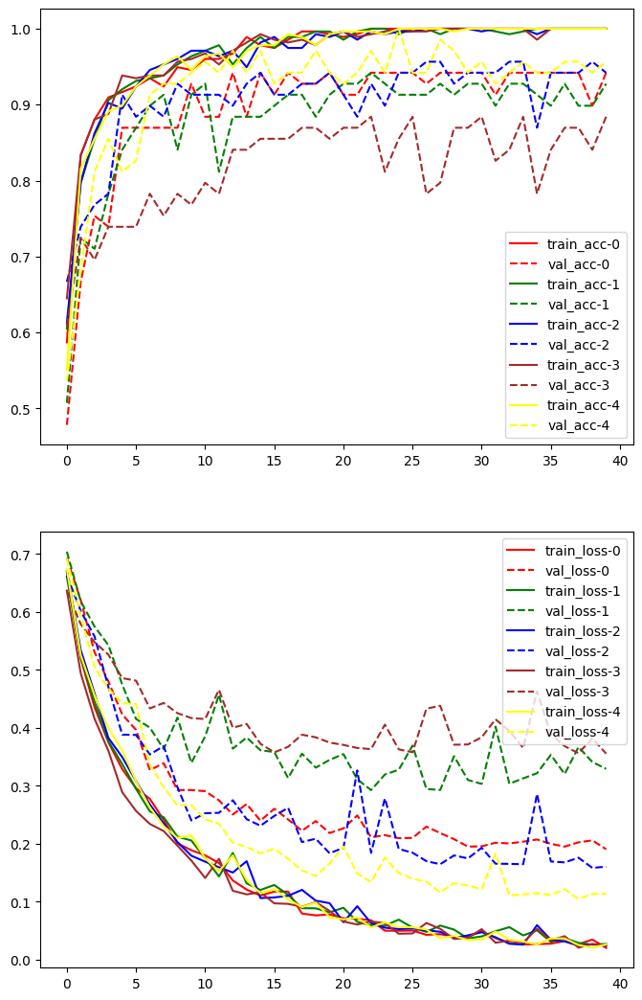

In [32]:
plot_histories(histories_densenet201, 'historiese densenet201')

In [33]:
df_histories_densenet201 = pd.DataFrame(columns = ['train_loss', 'val_loss', 'train_acc', 'val_acc'])

for history in histories_densenet201 :
  df_histories_densenet201 = pd.concat([df_histories_densenet201,history])

df_histories_densenet201.to_csv('histories_densenet201.csv')

#### vgg16

In [34]:
model_vgg16 = models.vgg16(pretrained = True)
model_vgg16.classifier[6] = nn.Linear(4096, 2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 227MB/s]


In [35]:
model_vgg16

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [36]:
fold_results = []

summary_vgg16 = pd.DataFrame(columns = ['train_acc' , 'val_acc'])
histories_vgg16 = []

for fold, (train_idx, test_idx) in enumerate(kfold.split(train_data)):
  print(f"Fold {fold + 1}")
  print("-------")

  train_loader = DataLoader(
      dataset=train_data,
      batch_size=32,
      sampler=torch.utils.data.SubsetRandomSampler(train_idx),
  )

  val_loader = DataLoader(
      dataset=train_data,
      batch_size=32,
      sampler=torch.utils.data.SubsetRandomSampler(test_idx),
  )

  model_vgg16 = models.vgg16(pretrained = True)
  model_vgg16.classifier[6] = nn.Linear(4096, 2)

  cross_entropy = nn.CrossEntropyLoss()
  optimizer = torch.optim.SGD(model_vgg16.parameters() , lr=2e-3)


  histories_vgg16.append(train_model(model_vgg16, train_loader,val_loader,cross_entropy,optimizer,epochs))

  train_loss, train_acc = evaluate_model(model_vgg16, train_loader, cross_entropy)
  val_loss, val_acc = evaluate_model(model_vgg16,  val_loader, cross_entropy)

  print(f"train_loss: {train_loss} , val_loss: {val_loss}, train_acc: {train_acc}, val_acc: {val_acc}")
  summary_vgg16.loc[len(summary_vgg16.index)] = [train_acc , val_acc]

  fold_results.append(val_acc)

mean_accuracy = np.mean(fold_results)
print(f'\nMean Cross-Validation Accuracy: {mean_accuracy:.4f}')

Fold 1
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.5560334739477738, val_loss: 0.5030734400818313, train_acc: 0.7463768115942029, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.4639295417329539, val_loss: 0.4368438578170279, train_acc: 0.7934782608695652, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.43207737501116766, val_loss: 0.4111421842505966, train_acc: 0.8188405797101449, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.454249678314596, val_loss: 0.6268156015354654, train_acc: 0.8152173913043478, val_acc: 0.7246376811594203


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.40996287525564, val_loss: 0.5617424042328544, train_acc: 0.8297101449275363, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.41319480840710626, val_loss: 0.4742625621349915, train_acc: 0.8115942028985508, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.41758414455082105, val_loss: 0.4153114876885345, train_acc: 0.8043478260869565, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.36914731799692346, val_loss: 0.3816020009310349, train_acc: 0.8514492753623188, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.3706720173358917, val_loss: 0.3785678864173267, train_acc: 0.8623188405797102, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.31739470535430353, val_loss: 0.3218488246202469, train_acc: 0.8623188405797102, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.24603022570195404, val_loss: 0.3815090748063032, train_acc: 0.9166666666666666, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.2626380669897881, val_loss: 1.1107455440189526, train_acc: 0.9021739130434783, val_acc: 0.5217391304347826


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.341531195934268, val_loss: 0.34133492151032324, train_acc: 0.8731884057971014, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.23049130647078805, val_loss: 0.3295904190643974, train_acc: 0.9202898550724637, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.1840458955021872, val_loss: 0.3599309225877126, train_acc: 0.927536231884058, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.20891010199767956, val_loss: 0.29666942995095597, train_acc: 0.9347826086956522, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.1615666098136833, val_loss: 0.31068951064261835, train_acc: 0.9456521739130435, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.21424658510132114, val_loss: 0.35280278238697327, train_acc: 0.9130434782608695, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.15732457024463709, val_loss: 0.27958028601563495, train_acc: 0.9347826086956522, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.12104541905548262, val_loss: 0.26738252069639123, train_acc: 0.967391304347826, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.10380419141248516, val_loss: 0.232423509268657, train_acc: 0.9710144927536232, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.09163594872191333, val_loss: 0.48479028845178906, train_acc: 0.9782608695652174, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.11840492746104365, val_loss: 0.4383911023969236, train_acc: 0.9601449275362319, val_acc: 0.7536231884057971


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.42333460545194324, val_loss: 0.44863774465477985, train_acc: 0.8478260869565217, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.09549221050912056, val_loss: 0.3057272157807281, train_acc: 0.9746376811594203, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.07430541742107143, val_loss: 0.34250971761302673, train_acc: 0.9818840579710145, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.07656625204760095, val_loss: 0.35624957559765247, train_acc: 0.9710144927536232, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.06456721768431041, val_loss: 0.3200990682386834, train_acc: 0.9818840579710145, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.047312682521516, val_loss: 0.6429469740909078, train_acc: 0.9891304347826086, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.12713648276268572, val_loss: 0.34979731271016423, train_acc: 0.9492753623188406, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.04107939799491694, val_loss: 0.3442611825260995, train_acc: 0.9891304347826086, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.03997137918528439, val_loss: 0.3658246734597977, train_acc: 0.9963768115942029, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.02815145194746446, val_loss: 0.3495581003612049, train_acc: 1.0, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.029340385310891746, val_loss: 0.4373335692005745, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.022150229932605358, val_loss: 0.3633898358414139, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.019563354484305, val_loss: 0.31339574119319086, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.01741689235727856, val_loss: 0.38277865282894263, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.017154411237308945, val_loss: 0.3546500188716944, train_acc: 1.0, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.02375034768593268, val_loss: 0.29406538584094116, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.014712248145994068, val_loss: 0.3990737536409195, train_acc: 1.0, val_acc: 0.9130434782608695
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.004962871458543384 , val_loss: 0.3990726095178853, train_acc: 1.0, val_acc: 0.9130434782608695
Fold 2
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.5855739846609641, val_loss: 0.5594811109097108, train_acc: 0.6847826086956522, val_acc: 0.7101449275362319


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.5474121777907662, val_loss: 0.5703688039295916, train_acc: 0.7210144927536232, val_acc: 0.7536231884057971


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.4537099176558895, val_loss: 0.4973766527314117, train_acc: 0.7971014492753623, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.4432456700698189, val_loss: 0.5191610757855402, train_acc: 0.8115942028985508, val_acc: 0.7391304347826086


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.43210376863894256, val_loss: 0.6012374402388282, train_acc: 0.782608695652174, val_acc: 0.6521739130434783


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.40641564173974853, val_loss: 0.491550387247749, train_acc: 0.8115942028985508, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.3412287963041361, val_loss: 0.4124048879181129, train_acc: 0.855072463768116, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.34099639239518537, val_loss: 0.3954060576532198, train_acc: 0.8478260869565217, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.24664991402971573, val_loss: 0.5198185759178107, train_acc: 0.9130434782608695, val_acc: 0.7536231884057971


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.26543591808581696, val_loss: 0.4117288019346154, train_acc: 0.9130434782608695, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.23911862485650656, val_loss: 0.8073761818417604, train_acc: 0.8913043478260869, val_acc: 0.6376811594202898


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.28650985334230505, val_loss: 0.3647508206574813, train_acc: 0.8985507246376812, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.1847457179556722, val_loss: 0.3700823732044386, train_acc: 0.927536231884058, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.16524459270463474, val_loss: 0.37993655969267304, train_acc: 0.9492753623188406, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.2564534113027047, val_loss: 0.3548207956811656, train_acc: 0.9021739130434783, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.46062374179777893, val_loss: 0.3564297634622325, train_acc: 0.8152173913043478, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.16202550834935645, val_loss: 0.35198018203179043, train_acc: 0.9565217391304348, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.15859735811102219, val_loss: 0.5100415915493732, train_acc: 0.9384057971014492, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.14445409891398056, val_loss: 0.40330382706462475, train_acc: 0.9456521739130435, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.12031834302605063, val_loss: 0.3487197696298793, train_acc: 0.9746376811594203, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.10524615386258, val_loss: 0.34856580559542216, train_acc: 0.9710144927536232, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.09499731573505678, val_loss: 0.381439246615206, train_acc: 0.9746376811594203, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.0906616344616033, val_loss: 0.34510686885619507, train_acc: 0.9818840579710145, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.12680501911951148, val_loss: 1.6141981957615286, train_acc: 0.9528985507246377, val_acc: 0.6666666666666666


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.5214693628359532, val_loss: 0.3145297843477, train_acc: 0.822463768115942, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.09834455385588217, val_loss: 0.3597914085224055, train_acc: 0.9818840579710145, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.08487031122912532, val_loss: 0.3503699291875397, train_acc: 0.9710144927536232, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.06527357148951378, val_loss: 0.45922761928776035, train_acc: 0.9855072463768116, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.07338018602003223, val_loss: 0.3688178402574166, train_acc: 0.9782608695652174, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.11782785515854324, val_loss: 0.3736821572849716, train_acc: 0.9565217391304348, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.04319944637625114, val_loss: 0.34107072967226093, train_acc: 0.9963768115942029, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.036864949525266456, val_loss: 0.36633623400838045, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.03804575457521107, val_loss: 0.3820399939743937, train_acc: 0.9927536231884058, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.030342149318776268, val_loss: 0.4046220657402191, train_acc: 0.9927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.026694498794234318, val_loss: 0.4020342128081382, train_acc: 0.9963768115942029, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.02157618176947901, val_loss: 0.4088888021212989, train_acc: 0.9963768115942029, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.024939644622845925, val_loss: 0.4070081002470376, train_acc: 0.9927536231884058, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.021062297665554543, val_loss: 0.47473631453686865, train_acc: 0.9963768115942029, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.13686373991810757, val_loss: 0.3653302019920902, train_acc: 0.9601449275362319, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.016729636671210545, val_loss: 0.37692282591824944, train_acc: 1.0, val_acc: 0.9130434782608695
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.008916202109253061 , val_loss: 0.3769223582863376, train_acc: 1.0, val_acc: 0.9130434782608695
Fold 3
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6429942025654558, val_loss: 0.4841869922651761, train_acc: 0.6123188405797102, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.5152190971201744, val_loss: 0.41768328996672144, train_acc: 0.7463768115942029, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.5670506332231604, val_loss: 0.40254261182702106, train_acc: 0.7536231884057971, val_acc: 0.8115942028985508


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.43449436322502466, val_loss: 0.43999713486519415, train_acc: 0.8260869565217391, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.3937723705734032, val_loss: 0.36716464896132983, train_acc: 0.8188405797101449, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.3713454690532408, val_loss: 0.3369324026980262, train_acc: 0.8731884057971014, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.4549641989279484, val_loss: 0.3384061818537505, train_acc: 0.7898550724637681, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.3427801503651384, val_loss: 0.3468265524808911, train_acc: 0.8623188405797102, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.3392309136148812, val_loss: 0.5234031361946161, train_acc: 0.8695652173913043, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.3005426854327105, val_loss: 0.2951344558294269, train_acc: 0.8913043478260869, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.27897104232207587, val_loss: 0.3493712056374204, train_acc: 0.894927536231884, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.3295828043550685, val_loss: 0.3030159136523371, train_acc: 0.8586956521739131, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.24690232868643774, val_loss: 0.3273220698254696, train_acc: 0.9094202898550725, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.22337409594784613, val_loss: 0.3589788848075314, train_acc: 0.9384057971014492, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.2454005900932395, val_loss: 0.32105156476946844, train_acc: 0.9166666666666666, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.26470911934755853, val_loss: 0.9435281632603079, train_acc: 0.8913043478260869, val_acc: 0.5507246376811594


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.2803994588877844, val_loss: 0.29581140694410907, train_acc: 0.8913043478260869, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.21356010113073431, val_loss: 0.2816014333047729, train_acc: 0.9166666666666666, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.1596815105581629, val_loss: 0.3400540248207424, train_acc: 0.9456521739130435, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.14358365492544312, val_loss: 0.3238576538320901, train_acc: 0.9565217391304348, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.23871827352306116, val_loss: 0.30518692515898443, train_acc: 0.9094202898550725, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.14378963734792627, val_loss: 0.406679208619871, train_acc: 0.9492753623188406, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.11539300606734511, val_loss: 0.33376126790392224, train_acc: 0.9601449275362319, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.0978436174168103, val_loss: 0.2905222792988238, train_acc: 0.9782608695652174, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.13112363543199457, val_loss: 0.24304835854665094, train_acc: 0.9492753623188406, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.09709260483150897, val_loss: 0.2957653256430142, train_acc: 0.967391304347826, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.061383082598879715, val_loss: 0.37722387515764305, train_acc: 0.9782608695652174, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.11954424605853316, val_loss: 1.2057190010513084, train_acc: 0.9420289855072463, val_acc: 0.7246376811594203


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.475476677974929, val_loss: 0.254180314856163, train_acc: 0.8659420289855072, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.06909620535114537, val_loss: 0.2809909651244896, train_acc: 0.9927536231884058, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.06063337046383084, val_loss: 0.32407053889355797, train_acc: 0.9855072463768116, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.05903414269720299, val_loss: 0.29163251282053365, train_acc: 0.9855072463768116, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.05156355966692385, val_loss: 0.26508999043616693, train_acc: 0.9818840579710145, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.04913130089424658, val_loss: 0.26735475443411566, train_acc: 0.9855072463768116, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.05130546982737555, val_loss: 0.291521902533545, train_acc: 0.9855072463768116, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.03724596751988798, val_loss: 0.2818419748134371, train_acc: 0.9927536231884058, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.024228252119560173, val_loss: 0.31936322876076767, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.0233850525557131, val_loss: 0.32621125552965247, train_acc: 0.9963768115942029, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.028090386287025784, val_loss: 0.2503617280635281, train_acc: 0.9891304347826086, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.021820500951962196, val_loss: 0.30010020646496094, train_acc: 1.0, val_acc: 0.8985507246376812
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.010087227867241356 , val_loss: 0.300099726172461, train_acc: 1.0, val_acc: 0.8985507246376812
Fold 4
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6723636501077292, val_loss: 0.5722809580789097, train_acc: 0.605072463768116, val_acc: 0.6956521739130435


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.5170354091602823, val_loss: 0.5071925996006399, train_acc: 0.75, val_acc: 0.7246376811594203


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.4406603423581607, val_loss: 0.5215683946574944, train_acc: 0.8079710144927537, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.39400943379471265, val_loss: 0.5027171960775403, train_acc: 0.8442028985507246, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.42326062788134033, val_loss: 0.4881412559661312, train_acc: 0.8297101449275363, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.39173166043516516, val_loss: 0.6909068611221038, train_acc: 0.8478260869565217, val_acc: 0.6811594202898551


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.40406325157137885, val_loss: 0.7220324174217556, train_acc: 0.822463768115942, val_acc: 0.6666666666666666


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.3454301901485609, val_loss: 0.42214763207712036, train_acc: 0.8731884057971014, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.3153446899807971, val_loss: 0.5456109871898872, train_acc: 0.894927536231884, val_acc: 0.7391304347826086


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.27198772413143213, val_loss: 0.4520564221817514, train_acc: 0.8876811594202898, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.305895972079125, val_loss: 0.5182421073533486, train_acc: 0.9094202898550725, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.2648679320363031, val_loss: 0.5531604575074237, train_acc: 0.894927536231884, val_acc: 0.7246376811594203


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.2708010091513827, val_loss: 0.8340078568544941, train_acc: 0.9021739130434783, val_acc: 0.6666666666666666


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.329101820786794, val_loss: 0.34305879905603937, train_acc: 0.8586956521739131, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.2277860494627469, val_loss: 0.3560557771420133, train_acc: 0.9021739130434783, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.2541464536950208, val_loss: 0.5499342716690423, train_acc: 0.8876811594202898, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.21806745252747467, val_loss: 0.3847590641698975, train_acc: 0.9202898550724637, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.20871365091938904, val_loss: 0.3174751759439275, train_acc: 0.9384057971014492, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.15982599664425504, val_loss: 0.5010223665099213, train_acc: 0.9456521739130435, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.1938807441704515, val_loss: 0.3018735677435778, train_acc: 0.9166666666666666, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.1474340260028839, val_loss: 0.46814786178478296, train_acc: 0.9528985507246377, val_acc: 0.7971014492753623


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.1210710974275202, val_loss: 0.3140625992546911, train_acc: 0.9601449275362319, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.1035545728560807, val_loss: 0.3284123414668484, train_acc: 0.9637681159420289, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.08229090489339137, val_loss: 0.3048822015955828, train_acc: 0.9746376811594203, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.5561304532963297, val_loss: 0.371036430199941, train_acc: 0.8152173913043478, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.12702145654222238, val_loss: 0.32602575712877774, train_acc: 0.9710144927536232, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.0837711709133093, val_loss: 0.2992460435067398, train_acc: 0.9818840579710145, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.0715024740151737, val_loss: 0.2893573410701061, train_acc: 0.9782608695652174, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.08684112914446471, val_loss: 0.29015560599340906, train_acc: 0.967391304347826, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.05760186575893043, val_loss: 0.39348809442658356, train_acc: 0.9891304347826086, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.056148026624451515, val_loss: 0.3455748795599177, train_acc: 0.9818840579710145, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.04449032457626384, val_loss: 0.37226705317911896, train_acc: 0.9891304347826086, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.04128552266005157, val_loss: 0.4833794312848561, train_acc: 0.9818840579710145, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.0328817127029533, val_loss: 0.3175851469454558, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.03499381492535273, val_loss: 0.5012966968875, train_acc: 0.9963768115942029, val_acc: 0.8405797101449275


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.023880957666298618, val_loss: 0.33993053565854614, train_acc: 1.0, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.022982460784091465, val_loss: 0.31921469301417255, train_acc: 0.9963768115942029, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.026457648994266125, val_loss: 0.42430750528971356, train_acc: 0.9927536231884058, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.02260947915846887, val_loss: 0.379900632183189, train_acc: 0.9963768115942029, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.018519237259591835, val_loss: 0.4326189462689386, train_acc: 0.9963768115942029, val_acc: 0.8840579710144928
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.009685930741977865 , val_loss: 0.432614683241084, train_acc: 1.0, val_acc: 0.8840579710144928
Fold 5
-------


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


True


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6716235288675281, val_loss: 0.5026910032915033, train_acc: 0.605072463768116, val_acc: 0.7681159420289855


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.592895653800688, val_loss: 0.5306645627470984, train_acc: 0.6811594202898551, val_acc: 0.7246376811594203


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.516765677842541, val_loss: 0.3550184040829755, train_acc: 0.7608695652173914, val_acc: 0.8840579710144928


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.4880647175553916, val_loss: 0.3147960490938546, train_acc: 0.7971014492753623, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.47106889970060706, val_loss: 0.30454396532065625, train_acc: 0.7971014492753623, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.3843550535215848, val_loss: 0.37381572611090064, train_acc: 0.8405797101449275, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.3484327434629634, val_loss: 0.657349427541097, train_acc: 0.8586956521739131, val_acc: 0.7536231884057971


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.45487936294597126, val_loss: 0.28142616109571594, train_acc: 0.8115942028985508, val_acc: 0.8695652173913043


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.3442997504835543, val_loss: 0.36984632714934973, train_acc: 0.8695652173913043, val_acc: 0.855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.36099753258884815, val_loss: 0.23045961494031159, train_acc: 0.8333333333333334, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.32202286089676013, val_loss: 0.6010216396787892, train_acc: 0.8731884057971014, val_acc: 0.782608695652174


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.4546377101670141, val_loss: 0.24846510513537173, train_acc: 0.8188405797101449, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.25549703663673956, val_loss: 0.22392495494821799, train_acc: 0.9057971014492754, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.3370837787355202, val_loss: 0.23081583173378653, train_acc: 0.8405797101449275, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.25698248761287634, val_loss: 0.20488686103751694, train_acc: 0.9057971014492754, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.4843187934678534, val_loss: 0.19951328764791074, train_acc: 0.8478260869565217, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.26364068276640296, val_loss: 0.19138853089964908, train_acc: 0.9021739130434783, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.2100884823695473, val_loss: 0.1654608732332354, train_acc: 0.9239130434782609, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.2004702777966209, val_loss: 0.1602710224148156, train_acc: 0.9239130434782609, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.2190889323103255, val_loss: 0.41477196112923, train_acc: 0.9094202898550725, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.250261807139369, val_loss: 0.22107677442440088, train_acc: 0.8876811594202898, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.1578644008740135, val_loss: 0.23996672520171042, train_acc: 0.9565217391304348, val_acc: 0.8985507246376812


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.18051871182262033, val_loss: 0.20372057069038998, train_acc: 0.927536231884058, val_acc: 0.9130434782608695


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.12338902423347252, val_loss: 0.48969515596610913, train_acc: 0.9565217391304348, val_acc: 0.8260869565217391


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.1747049687133319, val_loss: 0.1645488930137261, train_acc: 0.9166666666666666, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.33684833455776825, val_loss: 0.14999683644028677, train_acc: 0.8478260869565217, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.1019041074466878, val_loss: 0.11921879001285719, train_acc: 0.9782608695652174, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.08840655373490375, val_loss: 0.1044885269973589, train_acc: 0.967391304347826, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.08403539117695628, val_loss: 0.11407823887640152, train_acc: 0.9637681159420289, val_acc: 0.9710144927536232


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.41578204821849213, val_loss: 0.9291716256867284, train_acc: 0.8514492753623188, val_acc: 0.6811594202898551


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.25553774682508, val_loss: 0.14843781465205594, train_acc: 0.9239130434782609, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.08821905782257301, val_loss: 0.09882398575976276, train_acc: 0.9891304347826086, val_acc: 0.9855072463768116


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.06676643546940624, val_loss: 0.1715018325957699, train_acc: 0.9818840579710145, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.06316234095804933, val_loss: 0.19160285743250363, train_acc: 0.9855072463768116, val_acc: 0.927536231884058


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.05154935999409012, val_loss: 0.1337082666763361, train_acc: 0.9855072463768116, val_acc: 0.9565217391304348


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.04058073320682498, val_loss: 0.12049496805538303, train_acc: 0.9927536231884058, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.03652955205652161, val_loss: 0.11684938271840413, train_acc: 0.9927536231884058, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.027973281530042488, val_loss: 0.12545129770170088, train_acc: 0.9963768115942029, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.020968740509040115, val_loss: 0.09311730943728184, train_acc: 1.0, val_acc: 0.9420289855072463


  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.0198567610072053, val_loss: 0.09213484710325366, train_acc: 0.9963768115942029, val_acc: 0.9710144927536232
True


  0%|          | 0/9 [00:00<?, ?it/s]

True


  0%|          | 0/3 [00:00<?, ?it/s]

train_loss: 0.010891539901764929 , val_loss: 0.09213465792329414, train_acc: 1.0, val_acc: 0.9710144927536232

Mean Cross-Validation Accuracy: 0.9159


In [37]:
summary_vgg16

,train_acc,val_acc
0,1.0,0.913043
1,1.0,0.913043
2,1.0,0.898551
3,1.0,0.884058
4,1.0,0.971014


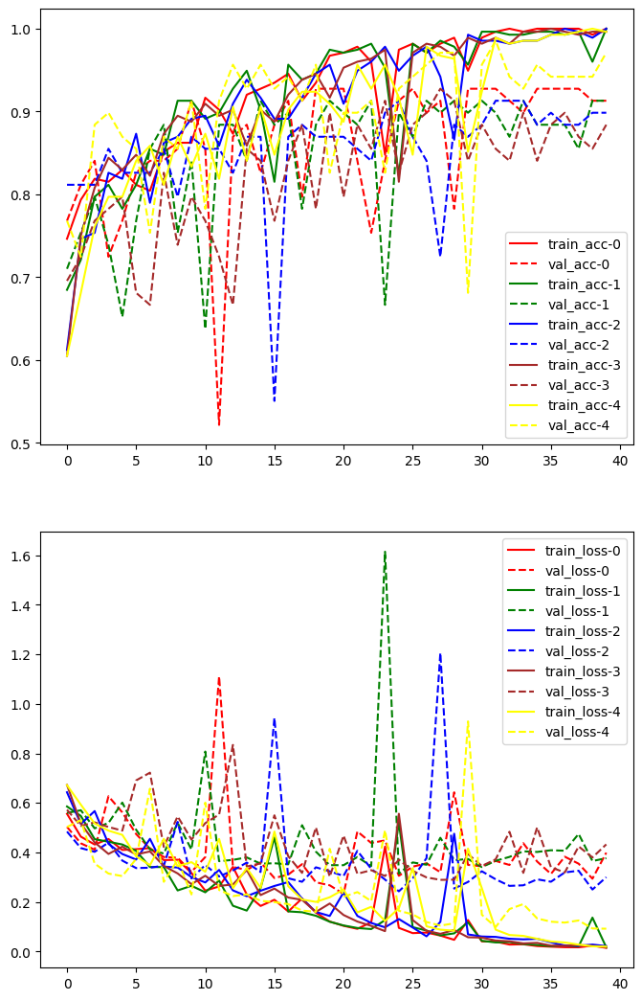

In [38]:
plot_histories(histories_vgg16, 'histories_vgg16')

In [39]:
df_histories_vgg16 = pd.DataFrame(columns = ['train_loss', 'val_loss', 'train_acc', 'val_acc'])

for history in histories_vgg16 :
  df_histories_vgg16 = pd.concat([df_histories_vgg16,history])

df_histories_vgg16.to_csv('histories_vgg16.csv')

# Analyze

## resnet34

In [61]:
histories_resnet34 = []
df = pd.read_csv('/content/histories_resnet34.csv')

curr = 0

for i in range(0,5) :
  history = df.loc[curr:curr+epochs-1 , ['train_loss','val_loss','train_acc','val_acc']].reset_index(drop = True)
  histories_resnet34.append(history)
  print(f"start: {curr} , end: {curr+epochs-1}")
  curr += epochs

start: 0 , end: 39
start: 40 , end: 79
start: 80 , end: 119
start: 120 , end: 159
start: 160 , end: 199


In [62]:
for history in histories_resnet34 :
  print(history.shape)

(40, 4)
(40, 4)
(40, 4)
(40, 4)
(40, 4)


In [63]:
histories_resnet34[1].head()

,train_loss,val_loss,train_acc,val_acc
0,0.623699,0.710577,0.677536,0.637681
1,0.427097,0.511574,0.873188,0.782609
2,0.338204,0.431998,0.902174,0.826087
3,0.281052,0.379651,0.938406,0.840580
4,0.223831,0.372365,0.960145,0.855072


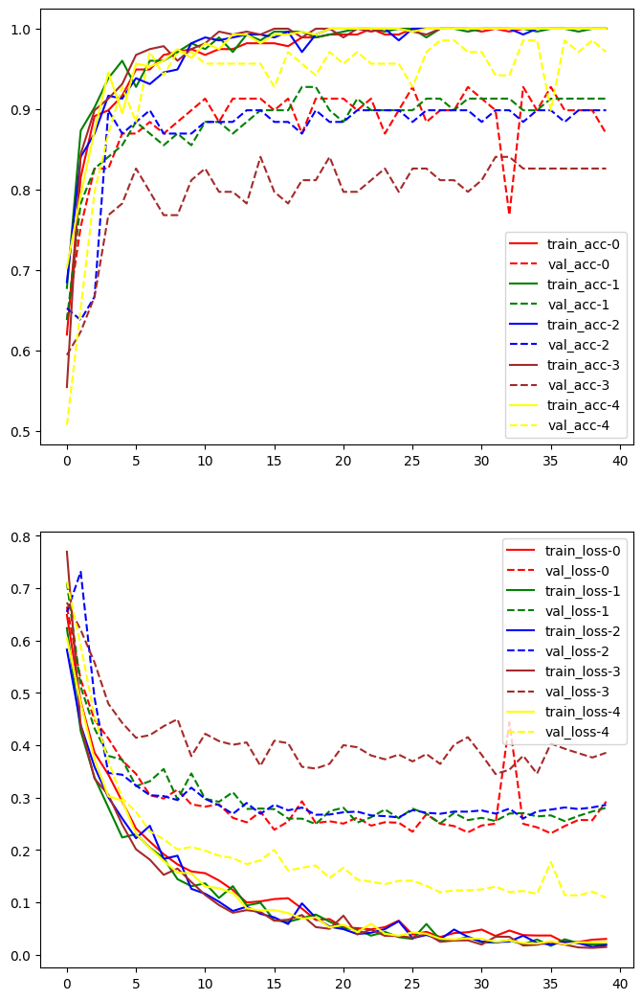

In [64]:
plot_histories(histories_resnet34, 'histories_resnet34')

## resnet50

In [65]:
histories_resnet50 = []
df = pd.read_csv('/content/histories_resnet50.csv')

curr = 0

for i in range(0,5) :
  history = df.loc[curr:curr+epochs-1 , ['train_loss','val_loss','train_acc','val_acc']].reset_index(drop = True)
  histories_resnet50.append(history)
  print(f"start: {curr} , end: {curr+epochs-1}")
  curr += epochs

start: 0 , end: 39
start: 40 , end: 79
start: 80 , end: 119
start: 120 , end: 159
start: 160 , end: 199


In [66]:
for history in histories_resnet50 :
  print(history.shape)

(40, 4)
(40, 4)
(40, 4)
(40, 4)
(40, 4)


In [67]:
histories_resnet50[1].head()

,train_loss,val_loss,train_acc,val_acc
0,0.664065,0.752451,0.641304,0.463768
1,0.558975,0.609596,0.786232,0.637681
2,0.479805,0.520906,0.862319,0.768116
3,0.428140,0.475458,0.884058,0.768116
4,0.376125,0.462540,0.884058,0.739130


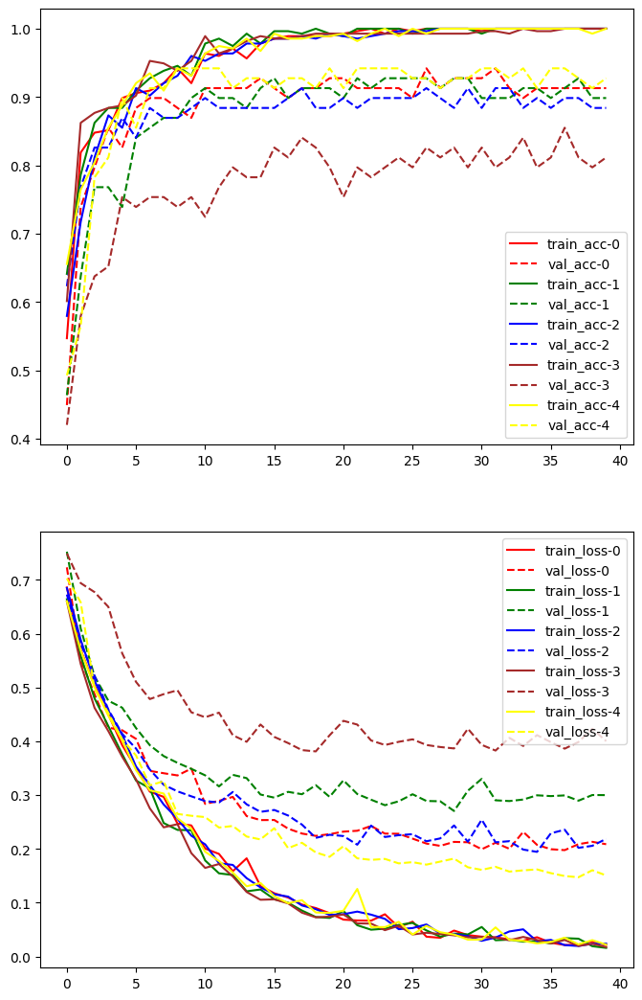

In [68]:
plot_histories(histories_resnet50, 'histories_resnet50')

## densenet121

In [69]:
histories_densenet121 = []
df = pd.read_csv('/content/histories_densenet121.csv')

curr = 0

for i in range(0,5) :
  history = df.loc[curr:curr+epochs-1 , ['train_loss','val_loss','train_acc','val_acc']].reset_index(drop = True)
  histories_densenet121.append(history)
  print(f"start: {curr} , end: {curr+epochs-1}")
  curr += epochs

start: 0 , end: 39
start: 40 , end: 79
start: 80 , end: 119
start: 120 , end: 159
start: 160 , end: 199


In [70]:
for history in histories_densenet121 :
  print(history.shape)

(40, 4)
(40, 4)
(40, 4)
(40, 4)
(40, 4)


In [71]:
histories_densenet121[1].head()

,train_loss,val_loss,train_acc,val_acc
0,0.613935,0.684167,0.666667,0.579710
1,0.474875,0.575707,0.840580,0.666667
2,0.403554,0.502241,0.855072,0.782609
3,0.345319,0.458256,0.909420,0.826087
4,0.293715,0.426769,0.927536,0.855072


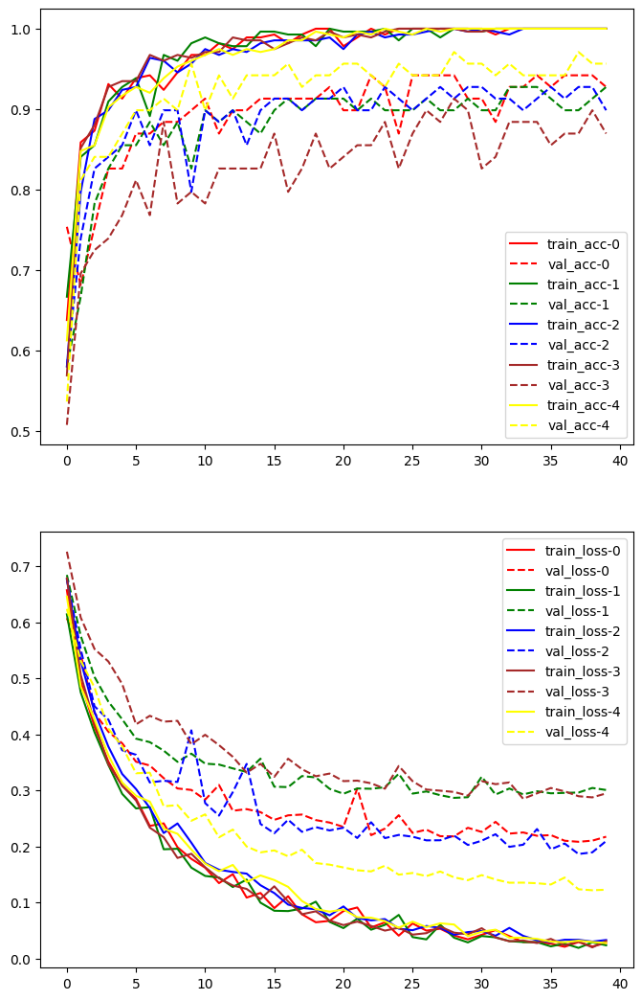

In [72]:
plot_histories(histories_densenet121, 'histories_densenet121')

## densenet201

In [73]:
histories_densenet201 = []
df = pd.read_csv('/content/histories_densenet201.csv')

curr = 0

for i in range(0,5) :
  history = df.loc[curr:curr+epochs-1 , ['train_loss','val_loss','train_acc','val_acc']].reset_index(drop = True)
  histories_densenet201.append(history)
  print(f"start: {curr} , end: {curr+epochs-1}")
  curr += epochs

start: 0 , end: 39
start: 40 , end: 79
start: 80 , end: 119
start: 120 , end: 159
start: 160 , end: 199


In [74]:
for history in histories_densenet201 :
  print(history.shape)

(40, 4)
(40, 4)
(40, 4)
(40, 4)
(40, 4)


In [75]:
histories_densenet201[3].tail()

,train_loss,val_loss,train_acc,val_acc
35,0.033776,0.389053,1.0,0.840580
36,0.040490,0.368447,1.0,0.869565
37,0.020703,0.356292,1.0,0.869565
38,0.027003,0.381904,1.0,0.840580
39,0.024840,0.355588,1.0,0.884058


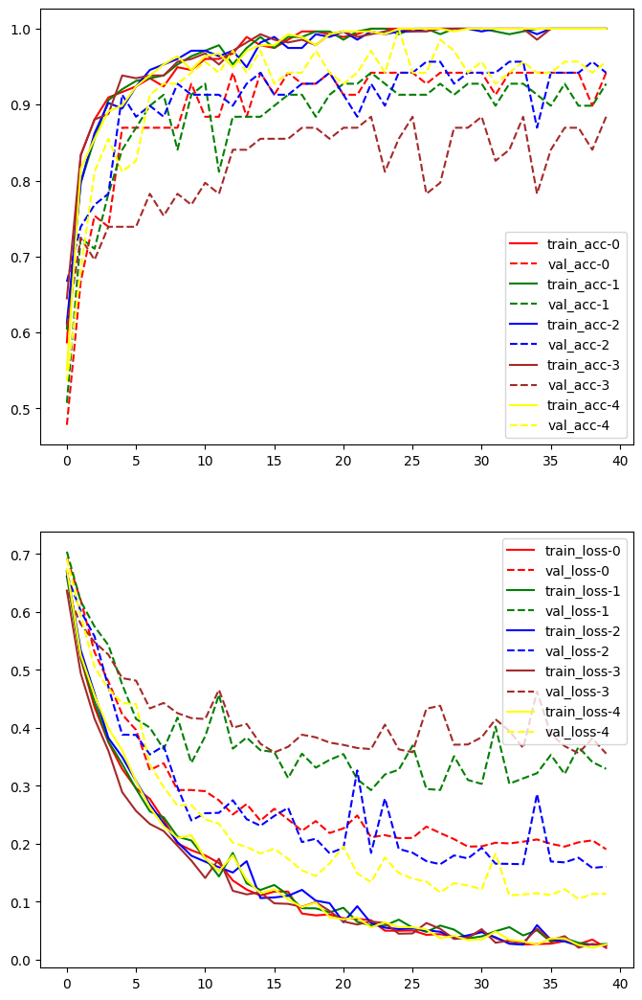

In [76]:
plot_histories(histories_densenet201, 'histories_densenet201')

## vgg16

In [85]:
histories_vgg16 = []
df = pd.read_csv('/content/histories_vgg16.csv')

curr = 0

for i in range(0,5) :
  history = df.loc[curr:curr+epochs-1 , ['train_loss','val_loss','train_acc','val_acc']].reset_index(drop = True)
  histories_vgg16.append(history)
  print(f"start: {curr} , end: {curr+epochs-1}")
  curr += epochs

start: 0 , end: 39
start: 40 , end: 79
start: 80 , end: 119
start: 120 , end: 159
start: 160 , end: 199


In [86]:
for history in histories_vgg16 :
  print(history.shape)

(40, 4)
(40, 4)
(40, 4)
(40, 4)
(40, 4)


In [87]:
histories_vgg16[4].tail()

,train_loss,val_loss,train_acc,val_acc
35,0.040581,0.120495,0.992754,0.942029
36,0.036530,0.116849,0.992754,0.942029
37,0.027973,0.125451,0.996377,0.942029
38,0.020969,0.093117,1.000000,0.942029
39,0.019857,0.092135,0.996377,0.971014


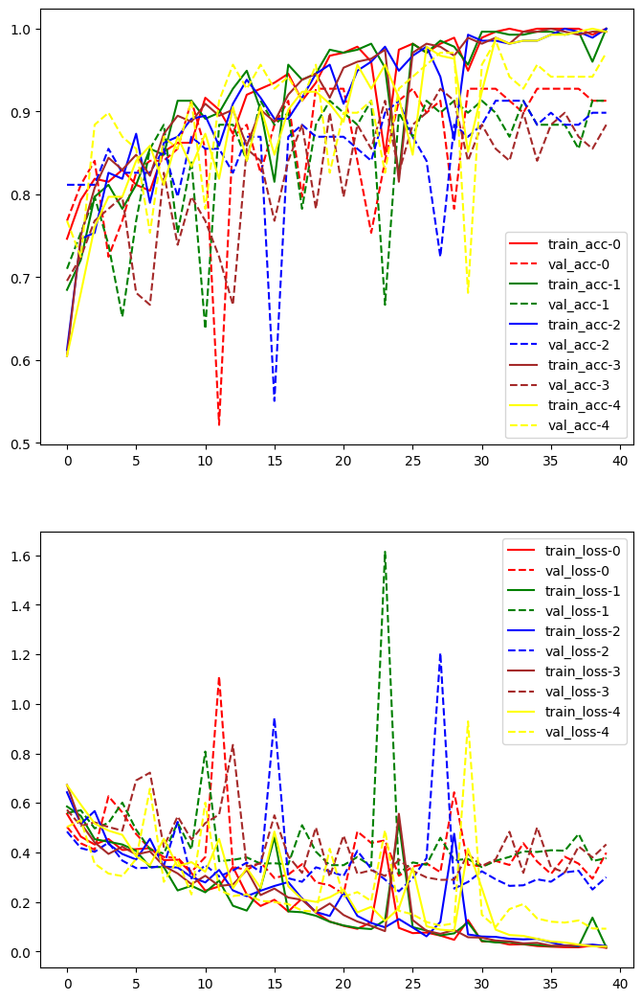

In [88]:
plot_histories(histories_vgg16, 'histories_vgg16')

# Evaluate with test set (20 images)

## Function: analyze

In [24]:
def display_confusionMatrix(y_true, y_pred) :
  matrix = metrics.confusion_matrix(y_true, y_pred)

  cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = matrix, display_labels = ['Healthy', 'Patient'])

  cm_display.plot()
  plt.show()

In [25]:
def tensor_to_numpy(tensor_image) :
  tensor_image_cpu = tensor_image.cpu()
  numpy_image = tensor_image_cpu.permute(1,2,0).numpy()
  return numpy_image

In [26]:
give_class = lambda is_PD : "PD" if is_PD else "H"

In [27]:
def display_wrong_output(model, loader) :
  gpu = torch.cuda.is_available()
  print(gpu)

  if gpu : model.cuda()

  model.eval()

  y_true = []
  y_pred = []

  false_images = []
  false_outputs = []

  for images , labels in tqdm(loader) :
    if gpu :
      images , labels = images.cuda() , labels.cuda()
    pred = model(images)
    yp = pred.argmax(dim=1).tolist()
    yt = labels.tolist()
    y_pred.extend(yp)
    y_true.extend(yt)
    for i in range(len(labels)) :
      if not yt[i] == yp[i] :
        # plt.imshow(images[i])
        # print(images[i])
        false_images.append(images[i])
        false_outputs.append([yt[i] , yp[i]])

  # print(false_images)
  print(classification_report(y_true , y_pred))

  plt.figure(figsize=(15,9))


  for i in range(len(false_outputs)) :
    actual, predicted = false_outputs[i]
    tensor_image = false_images[i]
    plt.subplot(1,len(false_outputs),i+1)
    plt.imshow(tensor_to_numpy(tensor_image))
    plt.title(f"{give_class(actual)} -> {give_class(predicted)}")
    plt.axis('off')

## Loader

In [28]:
train_loader_all = DataLoader(train_data , batch_size=32 , shuffle = True)
test_loader = DataLoader(test_data , batch_size=32 , shuffle = False)

In [29]:
train_loader_all.dataset

Dataset ImageFolder
    Number of datapoints: 345
    Root location: data/train/
    StandardTransform
Transform: Compose(
               Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=True)
               ToTensor()
               Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
           )

In [30]:
test_loader.dataset

Dataset ImageFolder
    Number of datapoints: 20
    Root location: data/test/
    StandardTransform
Transform: Compose(
               Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=True)
               ToTensor()
               Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
           )

## process

### resnet34

In [35]:
model_resnet34 = models.resnet34(pretrained=True)
model_resnet34.fc = nn.Linear(in_features=512, out_features=2)

In [36]:
cross_entropy = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(model_resnet34.parameters() , lr=2e-3)

In [37]:
history_resnet34 = train_model(model_resnet34, train_loader_all, test_loader,cross_entropy, optimizer,epochs)

True


  0%|          | 0/11 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.63547777455786, val_loss: 0.6409435272216797, train_acc: 0.6521739130434783, val_acc: 0.6


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.4237381056598995, val_loss: 0.5598123669624329, train_acc: 0.855072463768116, val_acc: 0.65


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.3561690423799598, val_loss: 0.460529088973999, train_acc: 0.8695652173913043, val_acc: 0.75


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.2857392647128174, val_loss: 0.38740816712379456, train_acc: 0.9130434782608695, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.23525830714598947, val_loss: 0.3573214113712311, train_acc: 0.936231884057971, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.18756876782230708, val_loss: 0.32396408915519714, train_acc: 0.9594202898550724, val_acc: 0.8


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.18705195236033287, val_loss: 0.3321828246116638, train_acc: 0.9536231884057971, val_acc: 0.8


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.1604493690141733, val_loss: 0.31022095680236816, train_acc: 0.9681159420289855, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.13438946928666987, val_loss: 0.29432371258735657, train_acc: 0.9797101449275363, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.12171333436516749, val_loss: 0.25379061698913574, train_acc: 0.9855072463768116, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.11479311831619428, val_loss: 0.2743390202522278, train_acc: 0.9768115942028985, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.09485133646622948, val_loss: 0.2391742467880249, train_acc: 0.9826086956521739, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.10069092741047127, val_loss: 0.23922359943389893, train_acc: 0.9797101449275363, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.07656459378591482, val_loss: 0.22548921406269073, train_acc: 0.9942028985507246, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.05677752457019212, val_loss: 0.22145715355873108, train_acc: 0.9971014492753624, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.055142452135898065, val_loss: 0.21417181193828583, train_acc: 1.0, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.059023424075997394, val_loss: 0.2281002700328827, train_acc: 0.9942028985507246, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.05553366952184318, val_loss: 0.2193489372730255, train_acc: 0.9942028985507246, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.05500133913280307, val_loss: 0.20643064379692078, train_acc: 0.9971014492753624, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.050099882990985674, val_loss: 0.2091864049434662, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.03672080258096474, val_loss: 0.20271191000938416, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.02929495336028977, val_loss: 0.2016899138689041, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.038069173110568004, val_loss: 0.20041128993034363, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.03554122183957825, val_loss: 0.20869839191436768, train_acc: 1.0, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.03376369621010794, val_loss: 0.19795240461826324, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.025157263966790144, val_loss: 0.20028074085712433, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.026086539953299192, val_loss: 0.1978408843278885, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.02744740314133789, val_loss: 0.1960289478302002, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.02165127924333016, val_loss: 0.2027476727962494, train_acc: 1.0, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.019263923400338147, val_loss: 0.20006594061851501, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.038467253485451575, val_loss: 0.22148339450359344, train_acc: 0.9971014492753624, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.018862830164531868, val_loss: 0.19371655583381653, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.015359569135783376, val_loss: 0.1943313330411911, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.023749620240667593, val_loss: 0.1896171122789383, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.016199739142388536, val_loss: 0.19450075924396515, train_acc: 1.0, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.015094224050425101, val_loss: 0.1966707408428192, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.024323163537875465, val_loss: 0.2094937264919281, train_acc: 1.0, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.014275133461300014, val_loss: 0.18635937571525574, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.011791791588715884, val_loss: 0.1916220337152481, train_acc: 1.0, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.013740472236405248, val_loss: 0.18401673436164856, train_acc: 1.0, val_acc: 0.95


train_loss val_loss train_acc val_acc 

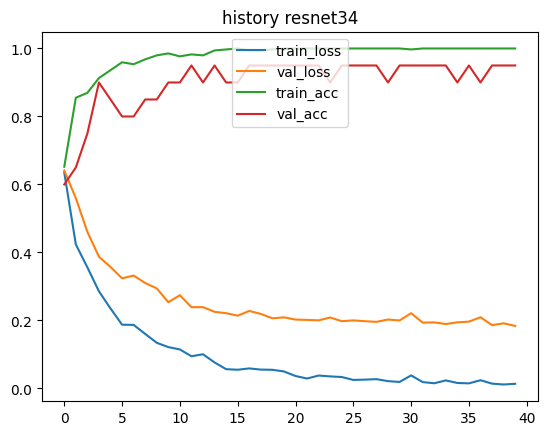

In [38]:
plot_history(history_resnet34 , history_resnet34.columns,'history resnet34')

True


  0%|          | 0/1 [00:00<?, ?it/s]

              precision    recall  f1-score   support

           0       0.91      1.00      0.95        10
           1       1.00      0.90      0.95        10

    accuracy                           0.95        20
   macro avg       0.95      0.95      0.95        20
weighted avg       0.95      0.95      0.95        20



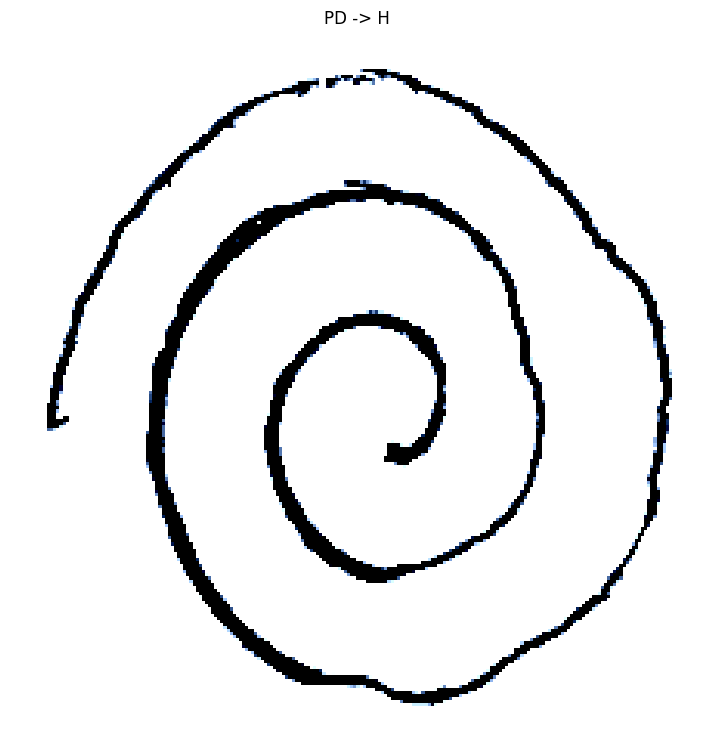

In [39]:
display_wrong_output(model_resnet34,test_loader)

### resnet50

In [47]:
model_resnet50 = models.resnet50(pretrained=True)
model_resnet50.fc = nn.Linear(in_features=2048, out_features=2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 209MB/s]


In [48]:
cross_entropy = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(model_resnet50.parameters() , lr=2e-3)

In [49]:
history_resnet50 = train_model(model_resnet50, train_loader_all, test_loader,cross_entropy, optimizer,epochs)

True


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6622426363005154, val_loss: 0.672141969203949, train_acc: 0.6347826086956522, val_acc: 0.55


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.5494384461554929, val_loss: 0.6412565112113953, train_acc: 0.8028985507246377, val_acc: 0.7


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.4743972991687664, val_loss: 0.5606228709220886, train_acc: 0.8492753623188406, val_acc: 0.7


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.4072808091191278, val_loss: 0.4927062392234802, train_acc: 0.8782608695652174, val_acc: 0.8


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.35925119182337883, val_loss: 0.4529148042201996, train_acc: 0.8898550724637682, val_acc: 0.7


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.3178715146970058, val_loss: 0.4184553027153015, train_acc: 0.9188405797101449, val_acc: 0.8


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.270024394557096, val_loss: 0.424917072057724, train_acc: 0.9304347826086956, val_acc: 0.75


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.252003371456395, val_loss: 0.4054316580295563, train_acc: 0.9391304347826087, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.20936511158943177, val_loss: 0.3379567265510559, train_acc: 0.9623188405797102, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.18688259919484457, val_loss: 0.3021734654903412, train_acc: 0.9681159420289855, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.18382548784864122, val_loss: 0.315544992685318, train_acc: 0.9594202898550724, val_acc: 0.8


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.17211423447166663, val_loss: 0.31459397077560425, train_acc: 0.9507246376811594, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.1378899191600689, val_loss: 0.2776225209236145, train_acc: 0.9710144927536232, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.11439700411713642, val_loss: 0.2683103680610657, train_acc: 0.9797101449275363, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.12688009497048197, val_loss: 0.2518157362937927, train_acc: 0.9710144927536232, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.09022115101848824, val_loss: 0.2652583122253418, train_acc: 0.9826086956521739, val_acc: 0.8


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.09586838993473329, val_loss: 0.252468079328537, train_acc: 0.9855072463768116, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.0744765728712082, val_loss: 0.23356518149375916, train_acc: 0.9942028985507246, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.10649467006973598, val_loss: 0.26086026430130005, train_acc: 0.9739130434782609, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.09388878799003103, val_loss: 0.23998117446899414, train_acc: 0.9884057971014493, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.0681859026460544, val_loss: 0.21242383122444153, train_acc: 0.9826086956521739, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.051591616447853005, val_loss: 0.22643327713012695, train_acc: 0.9971014492753624, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.04852805743398874, val_loss: 0.2187868058681488, train_acc: 1.0, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.03829461587727934, val_loss: 0.2040872573852539, train_acc: 1.0, val_acc: 0.8


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.044634050195631776, val_loss: 0.20453496277332306, train_acc: 1.0, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.0366443847724493, val_loss: 0.21706655621528625, train_acc: 0.9971014492753624, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.0331322664152021, val_loss: 0.2200077325105667, train_acc: 1.0, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.045148641653898834, val_loss: 0.23363617062568665, train_acc: 0.9971014492753624, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.029024660965238792, val_loss: 0.19826693832874298, train_acc: 1.0, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.036094026073165565, val_loss: 0.20785336196422577, train_acc: 0.9971014492753624, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.03138746219700661, val_loss: 0.19259527325630188, train_acc: 1.0, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.029215037779531616, val_loss: 0.2360125035047531, train_acc: 0.9971014492753624, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.019520122277131978, val_loss: 0.18875055015087128, train_acc: 1.0, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.021021719660232033, val_loss: 0.21112915873527527, train_acc: 1.0, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.02281078448978023, val_loss: 0.1912960559129715, train_acc: 1.0, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.025227935396242834, val_loss: 0.20009608566761017, train_acc: 1.0, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.028960370320988738, val_loss: 0.18465949594974518, train_acc: 1.0, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.019558892280295274, val_loss: 0.19333450496196747, train_acc: 1.0, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.01807066690230715, val_loss: 0.20141462981700897, train_acc: 1.0, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.014545479460039, val_loss: 0.19162091612815857, train_acc: 1.0, val_acc: 0.85


train_loss val_loss train_acc val_acc 

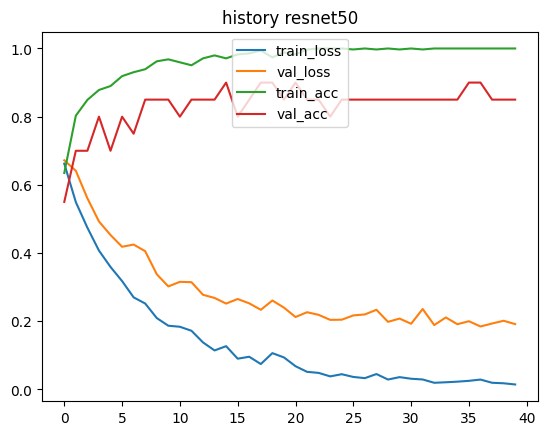

In [50]:
plot_history(history_resnet50 , history_resnet50.columns,'history resnet50')

True


  0%|          | 0/1 [00:00<?, ?it/s]

              precision    recall  f1-score   support

           0       0.89      0.80      0.84        10
           1       0.82      0.90      0.86        10

    accuracy                           0.85        20
   macro avg       0.85      0.85      0.85        20
weighted avg       0.85      0.85      0.85        20



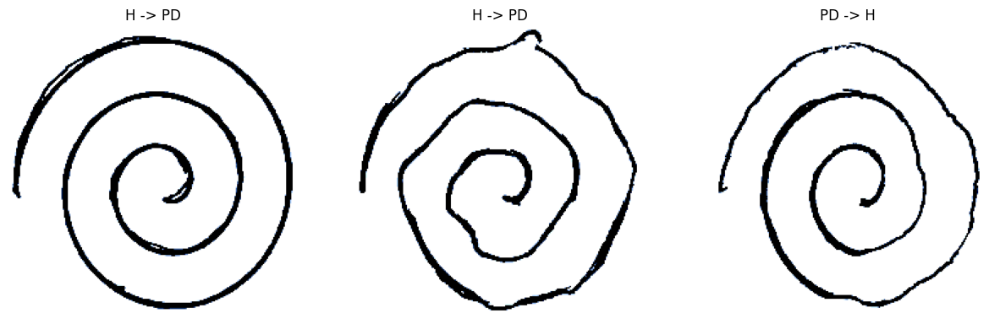

In [51]:
display_wrong_output(model_resnet50,test_loader)

### densenet121

In [54]:
model_densenet121 = models.densenet121(pretrained=True)
model_densenet121.classifier = nn.Linear(in_features=1024, out_features=2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 110MB/s] 


In [55]:
cross_entropy = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(model_densenet121.parameters() , lr=2e-3)

In [56]:
history_densenet121 = train_model(model_densenet121, train_loader_all, test_loader,cross_entropy, optimizer,epochs)

True


  0%|          | 0/11 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6071422569993613, val_loss: 0.6525694131851196, train_acc: 0.6985507246376812, val_acc: 0.7


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.4604068292223889, val_loss: 0.5544298887252808, train_acc: 0.8521739130434782, val_acc: 0.65


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.4010243234427079, val_loss: 0.5016821622848511, train_acc: 0.8666666666666667, val_acc: 0.65


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.3451945655587791, val_loss: 0.47326913475990295, train_acc: 0.8927536231884058, val_acc: 0.75


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.3053918132747429, val_loss: 0.372195839881897, train_acc: 0.9101449275362319, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.27246047025141507, val_loss: 0.34937530755996704, train_acc: 0.9188405797101449, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.24183106137358623, val_loss: 0.31125408411026, train_acc: 0.9420289855072463, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.2281381376411604, val_loss: 0.2585827708244324, train_acc: 0.9449275362318841, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.19352122813031294, val_loss: 0.2426084578037262, train_acc: 0.9478260869565217, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.18450403209181798, val_loss: 0.23075246810913086, train_acc: 0.9594202898550724, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.14919442283934442, val_loss: 0.20841571688652039, train_acc: 0.9739130434782609, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.16067678256743195, val_loss: 0.1947031170129776, train_acc: 0.9594202898550724, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.13859210845784864, val_loss: 0.19631150364875793, train_acc: 0.9652173913043478, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.1159359338922777, val_loss: 0.19428613781929016, train_acc: 0.9768115942028985, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.11405519182267396, val_loss: 0.1542312204837799, train_acc: 0.9739130434782609, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.10700664390688357, val_loss: 0.21708998084068298, train_acc: 0.9768115942028985, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.12224783113469248, val_loss: 0.13092435896396637, train_acc: 0.9681159420289855, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.08788709014222242, val_loss: 0.13565880060195923, train_acc: 0.9884057971014493, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.08126690936261328, val_loss: 0.12437848001718521, train_acc: 0.9942028985507246, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.08010896610608999, val_loss: 0.12504956126213074, train_acc: 0.9884057971014493, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.06870638039233028, val_loss: 0.1166629046201706, train_acc: 0.9942028985507246, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.08276218737381091, val_loss: 0.10988749563694, train_acc: 0.9855072463768116, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.05394941956020784, val_loss: 0.11763226985931396, train_acc: 0.9942028985507246, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.06274581644414128, val_loss: 0.10763511806726456, train_acc: 0.9942028985507246, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.04935822855087294, val_loss: 0.10597280412912369, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.03904547924580781, val_loss: 0.10770616680383682, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.06387218142981115, val_loss: 0.09688493609428406, train_acc: 0.9942028985507246, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.04100821090565211, val_loss: 0.11349563300609589, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.03413941606447317, val_loss: 0.09332702308893204, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.04604937578888907, val_loss: 0.08705124258995056, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.02872483628815499, val_loss: 0.08763939142227173, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.03667809477318888, val_loss: 0.08744413405656815, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.035585376814655637, val_loss: 0.07176954299211502, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.033253953222563304, val_loss: 0.0726456344127655, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.02332378569180551, val_loss: 0.07923094928264618, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.030735072126423103, val_loss: 0.08116081357002258, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.026563978354460088, val_loss: 0.07073775678873062, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.02611946426871894, val_loss: 0.0934034138917923, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.03489423302420672, val_loss: 0.06535939872264862, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.022186827648808992, val_loss: 0.0664512887597084, train_acc: 1.0, val_acc: 1.0


train_loss val_loss train_acc val_acc 

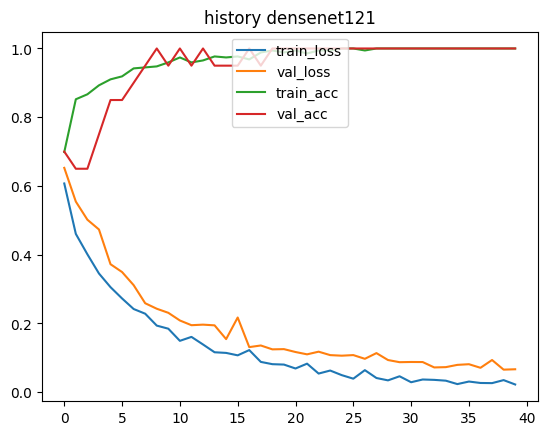

In [57]:
plot_history(history_densenet121 , history_densenet121.columns,'history densenet121')

In [58]:
display_wrong_output(model_densenet121,test_loader)

True


  0%|          | 0/1 [00:00<?, ?it/s]

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        10
           1       1.00      1.00      1.00        10

    accuracy                           1.00        20
   macro avg       1.00      1.00      1.00        20
weighted avg       1.00      1.00      1.00        20



<Figure size 1500x900 with 0 Axes>

### densenet201

In [59]:
model_densenet201 = models.densenet201(pretrained=True)
model_densenet201.classifier = nn.Linear(in_features=1920 , out_features=2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet201_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet201_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet201-c1103571.pth" to /root/.cache/torch/hub/checkpoints/densenet201-c1103571.pth
100%|██████████| 77.4M/77.4M [00:06<00:00, 13.0MB/s]


In [60]:
cross_entropy = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(model_densenet201.parameters() , lr=2e-3)

In [61]:
history_densenet201 = train_model(model_densenet201, train_loader_all, test_loader,cross_entropy, optimizer,epochs)

True


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6230736735938252, val_loss: 0.664072573184967, train_acc: 0.6492753623188405, val_acc: 0.6


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.49796557003173275, val_loss: 0.5481640100479126, train_acc: 0.8231884057971014, val_acc: 0.75


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.4010470396366672, val_loss: 0.5028135180473328, train_acc: 0.8869565217391304, val_acc: 0.65


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.35108338525329813, val_loss: 0.43506741523742676, train_acc: 0.9188405797101449, val_acc: 0.8


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.34826317844183546, val_loss: 0.400765597820282, train_acc: 0.881159420289855, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.2662220808042996, val_loss: 0.30065780878067017, train_acc: 0.9246376811594202, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.23138732296833095, val_loss: 0.25938767194747925, train_acc: 0.9391304347826087, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.22347047864526942, val_loss: 0.27561408281326294, train_acc: 0.9478260869565217, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.18759261602940766, val_loss: 0.200155571103096, train_acc: 0.9565217391304348, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.16357300253450008, val_loss: 0.19346413016319275, train_acc: 0.9594202898550724, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.1752527766469596, val_loss: 0.20246998965740204, train_acc: 0.9536231884057971, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.16089292751706163, val_loss: 0.2118186205625534, train_acc: 0.9507246376811594, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.1316164197049279, val_loss: 0.2036883533000946, train_acc: 0.9681159420289855, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.11106727745222009, val_loss: 0.16107650101184845, train_acc: 0.9768115942028985, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.09822614918584409, val_loss: 0.16850373148918152, train_acc: 0.9826086956521739, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.09490308901969938, val_loss: 0.12993860244750977, train_acc: 0.9826086956521739, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.08496196524820467, val_loss: 0.1331101357936859, train_acc: 0.9884057971014493, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.07685170283784037, val_loss: 0.10613717883825302, train_acc: 0.9884057971014493, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.08305132175269334, val_loss: 0.1059381514787674, train_acc: 0.9826086956521739, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.06992162358069766, val_loss: 0.09541110694408417, train_acc: 0.9942028985507246, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.05829314466403878, val_loss: 0.10806598514318466, train_acc: 0.9971014492753624, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.06146516024634458, val_loss: 0.1213260293006897, train_acc: 0.991304347826087, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.06650294734947923, val_loss: 0.09193537384271622, train_acc: 0.9884057971014493, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.04346646271322085, val_loss: 0.09892340004444122, train_acc: 0.9971014492753624, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.044729654814886013, val_loss: 0.08841844648122787, train_acc: 0.9971014492753624, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.038597777097121526, val_loss: 0.07843431830406189, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.03649466928580533, val_loss: 0.11682970821857452, train_acc: 0.9971014492753624, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.04657217441261678, val_loss: 0.13090547919273376, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.04318309802076091, val_loss: 0.21064022183418274, train_acc: 0.9942028985507246, val_acc: 0.95


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.03879155364373456, val_loss: 0.07166513800621033, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.04093618376747422, val_loss: 0.08273325860500336, train_acc: 0.9971014492753624, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.030164958520427994, val_loss: 0.10111276060342789, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.03542834956576859, val_loss: 0.059105612337589264, train_acc: 0.9971014492753624, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.030383202633348063, val_loss: 0.06487636268138885, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.022299287041676216, val_loss: 0.06057899072766304, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.02374371950501117, val_loss: 0.0654064416885376, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.022581973947260692, val_loss: 0.05427466705441475, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.04090101401443067, val_loss: 0.0823766216635704, train_acc: 0.9855072463768116, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.021433684294638426, val_loss: 0.0645606517791748, train_acc: 1.0, val_acc: 1.0


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.023981951228410438, val_loss: 0.06225452572107315, train_acc: 1.0, val_acc: 1.0


train_loss val_loss train_acc val_acc 

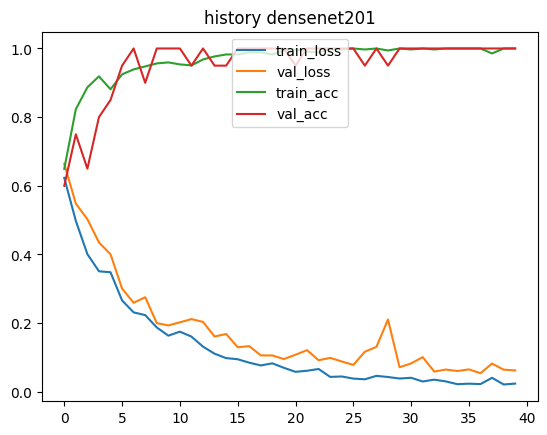

In [62]:
plot_history(history_densenet201 , history_densenet201.columns,'history densenet201')

In [63]:
display_wrong_output(model_densenet201,test_loader)

True


  0%|          | 0/1 [00:00<?, ?it/s]

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        10
           1       1.00      1.00      1.00        10

    accuracy                           1.00        20
   macro avg       1.00      1.00      1.00        20
weighted avg       1.00      1.00      1.00        20



<Figure size 1500x900 with 0 Axes>

### vgg16

In [39]:
model_vgg16 = models.vgg16(pretrained = True)
model_vgg16.classifier[6] = nn.Linear(4096, 2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [40]:
cross_entropy = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(model_vgg16.parameters() , lr=2e-3)

In [41]:
history_vgg16 = train_model(model_vgg16, train_loader_all, test_loader,cross_entropy, optimizer,epochs)

True


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 0 -> train_loss: 0.6447906597800876, val_loss: 0.8549567461013794, train_acc: 0.6347826086956522, val_acc: 0.65


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 1 -> train_loss: 0.547846752146016, val_loss: 0.724187970161438, train_acc: 0.744927536231884, val_acc: 0.5


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 2 -> train_loss: 0.4685540137083634, val_loss: 0.7016068696975708, train_acc: 0.7681159420289855, val_acc: 0.6


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 3 -> train_loss: 0.4466385556303937, val_loss: 0.6935175657272339, train_acc: 0.8057971014492754, val_acc: 0.6


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 4 -> train_loss: 0.39588180400323175, val_loss: 0.676753580570221, train_acc: 0.8463768115942029, val_acc: 0.6


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 5 -> train_loss: 0.3916716319063435, val_loss: 0.6371724605560303, train_acc: 0.8434782608695652, val_acc: 0.6


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 6 -> train_loss: 0.35917703863503275, val_loss: 0.5308789014816284, train_acc: 0.8463768115942029, val_acc: 0.75


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 7 -> train_loss: 0.3335583886374598, val_loss: 0.5039712190628052, train_acc: 0.8608695652173913, val_acc: 0.75


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 8 -> train_loss: 0.29011658663335055, val_loss: 0.5260624289512634, train_acc: 0.8840579710144928, val_acc: 0.7


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 9 -> train_loss: 0.2647142094978388, val_loss: 0.5016867518424988, train_acc: 0.9101449275362319, val_acc: 0.75


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 10 -> train_loss: 0.4426841194215028, val_loss: 0.4104461073875427, train_acc: 0.8347826086956521, val_acc: 0.75


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 11 -> train_loss: 0.2924625589363817, val_loss: 0.37341904640197754, train_acc: 0.8782608695652174, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 12 -> train_loss: 0.24961536751277205, val_loss: 0.3886887729167938, train_acc: 0.9014492753623189, val_acc: 0.75


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 13 -> train_loss: 0.19246861416360606, val_loss: 1.1434234380722046, train_acc: 0.9507246376811594, val_acc: 0.65


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 14 -> train_loss: 0.27735268879627833, val_loss: 0.6221200227737427, train_acc: 0.8869565217391304, val_acc: 0.7


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 15 -> train_loss: 0.19842180799746859, val_loss: 0.3263157606124878, train_acc: 0.9246376811594202, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 16 -> train_loss: 0.15982461100903111, val_loss: 0.33345791697502136, train_acc: 0.9333333333333333, val_acc: 0.8


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 17 -> train_loss: 0.1753720114196556, val_loss: 0.5175028443336487, train_acc: 0.9333333333333333, val_acc: 0.75


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 18 -> train_loss: 0.17680511779111366, val_loss: 0.2415553331375122, train_acc: 0.9391304347826087, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 19 -> train_loss: 0.1452580155885738, val_loss: 0.22512277960777283, train_acc: 0.9478260869565217, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 20 -> train_loss: 0.10218783874010694, val_loss: 0.2632695138454437, train_acc: 0.9623188405797102, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 21 -> train_loss: 0.16853229999542235, val_loss: 2.634565830230713, train_acc: 0.9159420289855073, val_acc: 0.6


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 22 -> train_loss: 0.3735142631807189, val_loss: 0.24838688969612122, train_acc: 0.8927536231884058, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 23 -> train_loss: 0.0994771826526393, val_loss: 0.22040176391601562, train_acc: 0.9681159420289855, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 24 -> train_loss: 0.08630660191394281, val_loss: 0.34152132272720337, train_acc: 0.9768115942028985, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 25 -> train_loss: 0.09245997064787409, val_loss: 0.19815126061439514, train_acc: 0.9768115942028985, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 26 -> train_loss: 0.0697551664882812, val_loss: 0.21505331993103027, train_acc: 0.9797101449275363, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 27 -> train_loss: 0.176447321690511, val_loss: 0.3271175026893616, train_acc: 0.9333333333333333, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 28 -> train_loss: 0.06149415481781614, val_loss: 0.17004968225955963, train_acc: 0.991304347826087, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 29 -> train_loss: 0.04533252367290898, val_loss: 0.1871993988752365, train_acc: 0.9884057971014493, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 30 -> train_loss: 0.03490521239413731, val_loss: 0.1884954869747162, train_acc: 0.9942028985507246, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 31 -> train_loss: 0.039052826020380724, val_loss: 0.16163794696331024, train_acc: 0.9942028985507246, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 32 -> train_loss: 0.0319244792252995, val_loss: 0.17135576903820038, train_acc: 0.9971014492753624, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 33 -> train_loss: 0.03812330226697352, val_loss: 0.1492011994123459, train_acc: 0.991304347826087, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 34 -> train_loss: 0.021688255160183148, val_loss: 0.15122084319591522, train_acc: 0.9971014492753624, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 35 -> train_loss: 0.019172614748063296, val_loss: 0.5915133953094482, train_acc: 0.9942028985507246, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 36 -> train_loss: 0.017249819609350053, val_loss: 0.2550670802593231, train_acc: 1.0, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 37 -> train_loss: 0.015205434504626454, val_loss: 0.1558282971382141, train_acc: 1.0, val_acc: 0.9


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 38 -> train_loss: 0.010650757272336362, val_loss: 0.17183749377727509, train_acc: 1.0, val_acc: 0.85


  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

epoch: 39 -> train_loss: 0.01917818829795157, val_loss: 0.18163441121578217, train_acc: 0.9942028985507246, val_acc: 0.9


train_loss val_loss train_acc val_acc 

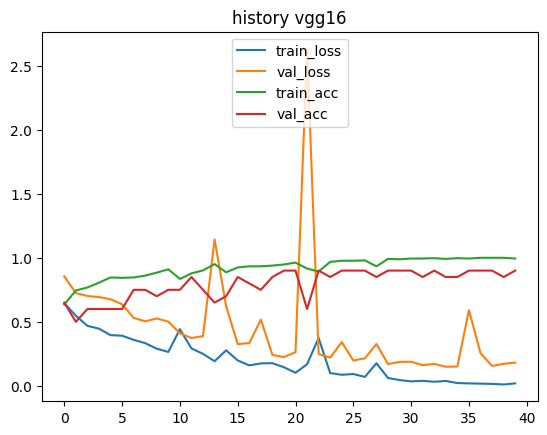

In [42]:
plot_history(history_vgg16 , history_vgg16.columns,'history vgg16')

True


  0%|          | 0/1 [00:00<?, ?it/s]

              precision    recall  f1-score   support

           0       1.00      0.80      0.89        10
           1       0.83      1.00      0.91        10

    accuracy                           0.90        20
   macro avg       0.92      0.90      0.90        20
weighted avg       0.92      0.90      0.90        20



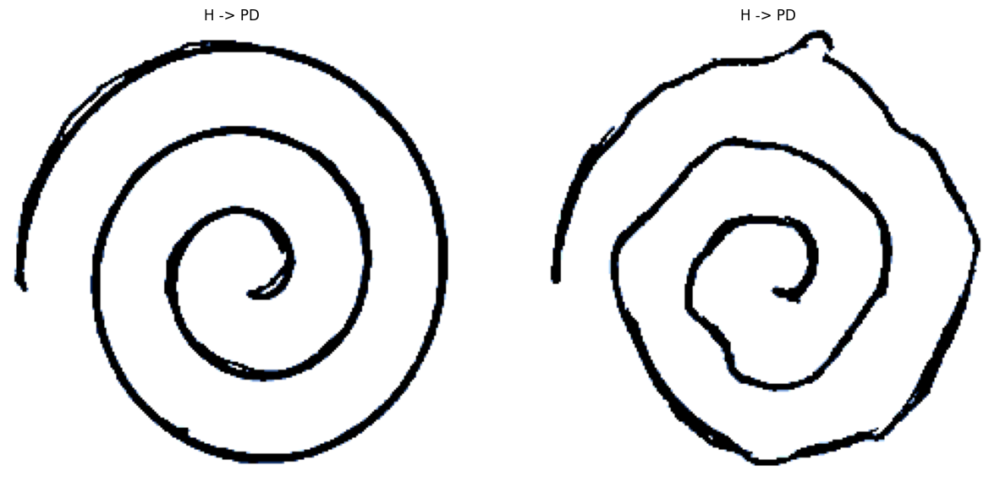

In [43]:
display_wrong_output(model_vgg16,test_loader)

# Save Model

In [63]:
torch.save( model_resnet34.state_dict(), 'model_resnet34.pth')

In [69]:
torch.save( model_resnet50.state_dict(), 'model_resnet50.pth')

In [ ]:
torch.save( model_densenet121.state_dict(), 'model_densenet121.pth')

In [ ]:
torch.save( model_densenet201.state_dict(), 'model_densenet201.pth')

In [44]:
torch.save( model_vgg16.state_dict(), 'model_vgg16.pth')

# My own testset

In [40]:
os.makedirs('myTest/Healthy')
os.makedirs('myTest/Patient')

In [41]:
myTest_data = datasets.ImageFolder("myTest/" , transform=transform)

In [42]:
myTest_loader = DataLoader(myTest_data , batch_size=32 , shuffle = False)

In [43]:
myTest_loader.dataset

Dataset ImageFolder
    Number of datapoints: 21
    Root location: myTest/
    StandardTransform
Transform: Compose(
               Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=True)
               ToTensor()
               Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
           )

In [44]:
def eval_myTest(model, loader) :
  gpu = torch.cuda.is_available()
  print(gpu)

  if gpu : model.cuda()

  model.eval()

  y_true = []
  y_pred = []

  false_images = []
  false_outputs = []

  for images , labels in tqdm(loader) :
    if gpu :
      images , labels = images.cuda() , labels.cuda()
    pred = model(images)
    yp = pred.argmax(dim=1).tolist()
    yt = labels.tolist()
    y_pred.extend(yp)
    y_true.extend(yt)
    for i in range(len(labels)) :
        # plt.imshow(images[i])
        # print(images[i])
        false_images.append(images[i])
        false_outputs.append([yt[i] , yp[i]])

  # print(false_images)
  print(classification_report(y_true , y_pred))

  plt.figure(figsize=(15,9))

  for i in range(len(false_outputs)) :
    actual, predicted = false_outputs[i]
    tensor_image = false_images[i]
    plt.subplot(2,12,i+1)
    plt.imshow(tensor_to_numpy(tensor_image))
    plt.title(f"{give_class(actual)} -> {give_class(predicted)}")
    plt.axis('off')
  return y_true, y_pred

## resnet34

True


  0%|          | 0/1 [00:00<?, ?it/s]

              precision    recall  f1-score   support

           0       1.00      0.20      0.33        20
           1       0.06      1.00      0.11         1

    accuracy                           0.24        21
   macro avg       0.53      0.60      0.22        21
weighted avg       0.96      0.24      0.32        21



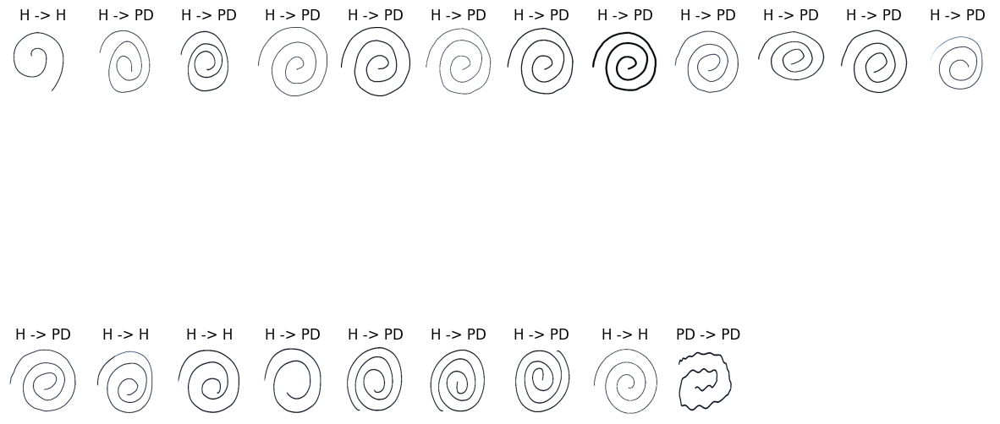

In [45]:
y_true,y_pred = eval_myTest(model_resnet34,myTest_loader)

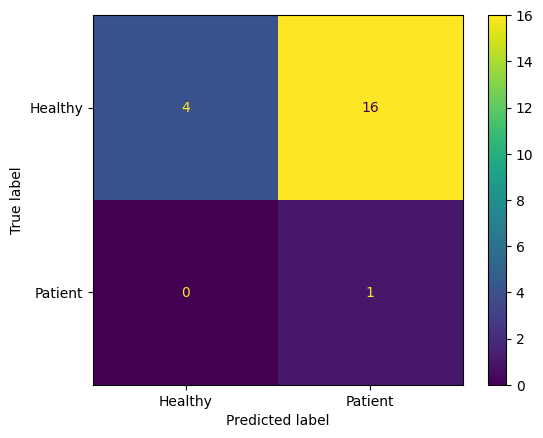

In [46]:
display_confusionMatrix(y_true,y_pred)

## resnet50

True


  0%|          | 0/1 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00        20
           1       0.05      1.00      0.09         1

    accuracy                           0.05        21
   macro avg       0.02      0.50      0.05        21
weighted avg       0.00      0.05      0.00        21



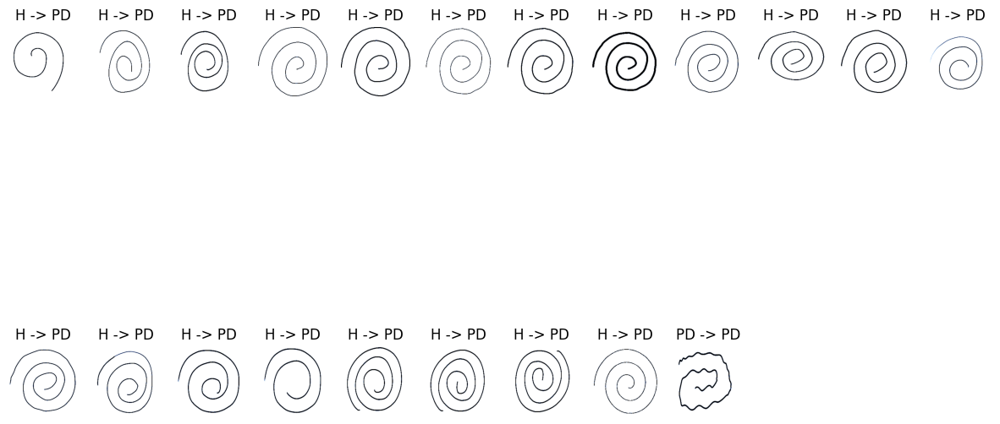

In [52]:
y_true,y_pred = eval_myTest(model_resnet50,myTest_loader)

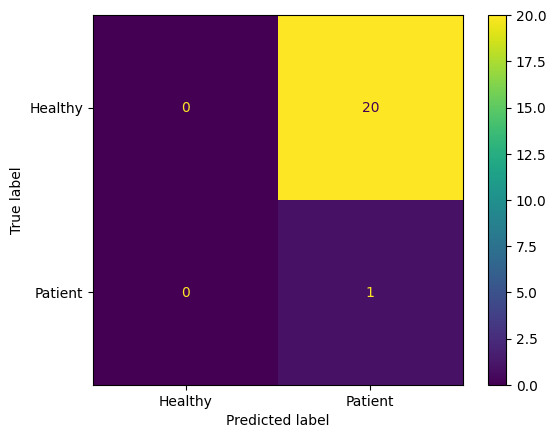

In [53]:
display_confusionMatrix(y_true,y_pred)

## densenet121

True


  0%|          | 0/1 [00:00<?, ?it/s]

              precision    recall  f1-score   support

           0       1.00      0.10      0.18        20
           1       0.05      1.00      0.10         1

    accuracy                           0.14        21
   macro avg       0.53      0.55      0.14        21
weighted avg       0.95      0.14      0.18        21



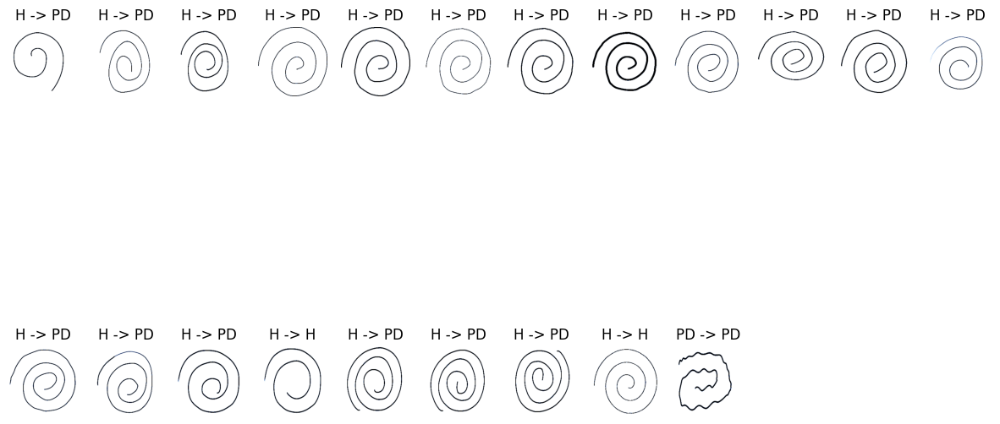

In [64]:
y_true,y_pred = eval_myTest(model_densenet121,myTest_loader)

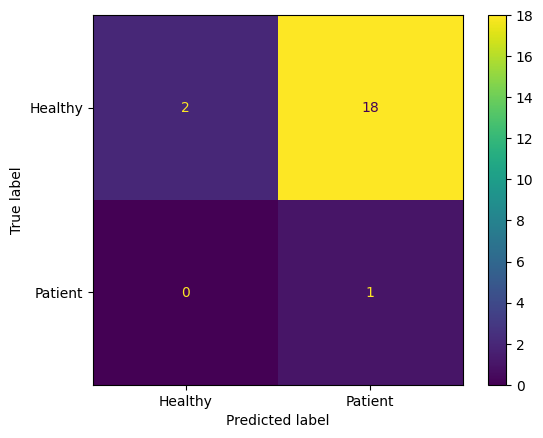

In [65]:
display_confusionMatrix(y_true,y_pred)

## densenet201

True


  0%|          | 0/1 [00:00<?, ?it/s]

              precision    recall  f1-score   support

           0       1.00      0.15      0.26        20
           1       0.06      1.00      0.11         1

    accuracy                           0.19        21
   macro avg       0.53      0.57      0.18        21
weighted avg       0.96      0.19      0.25        21



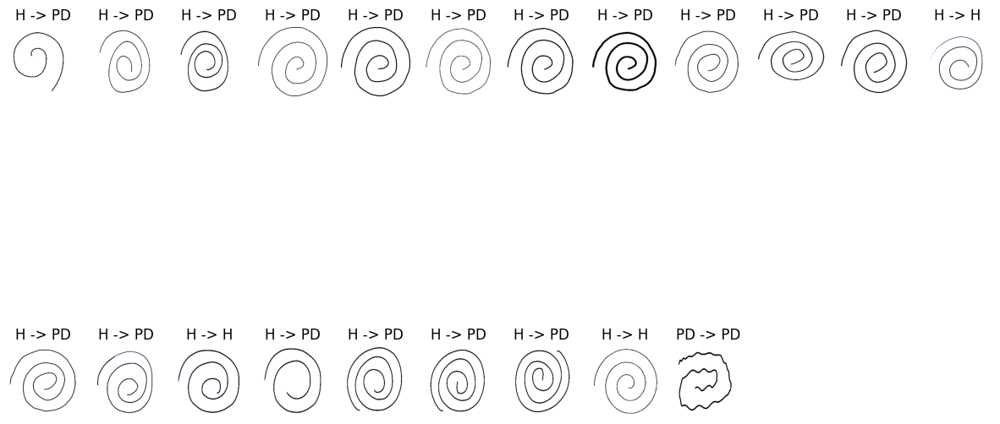

In [66]:
y_true,y_pred = eval_myTest(model_densenet201,myTest_loader)

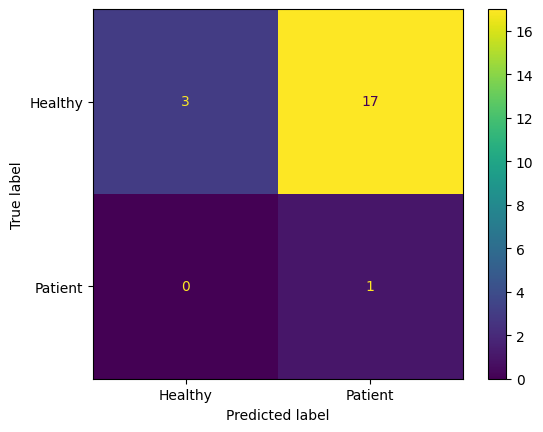

In [67]:
display_confusionMatrix(y_true,y_pred)

## vgg16

True


  0%|          | 0/1 [00:00<?, ?it/s]

              precision    recall  f1-score   support

           0       1.00      0.80      0.89        20
           1       0.20      1.00      0.33         1

    accuracy                           0.81        21
   macro avg       0.60      0.90      0.61        21
weighted avg       0.96      0.81      0.86        21



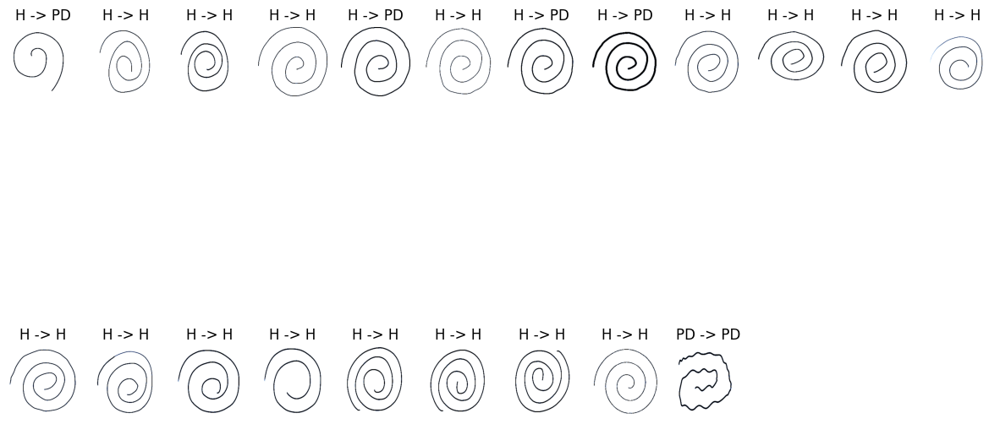

In [52]:
y_true,y_pred = eval_myTest(model_vgg16,myTest_loader)

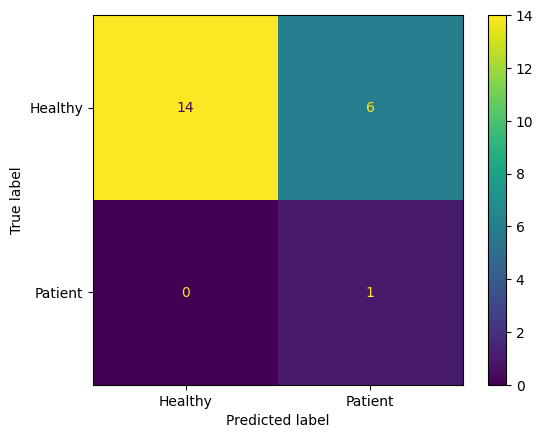

In [57]:
display_confusionMatrix(y_true,y_pred)